In [1]:
%config InlineBackend.figure_format = 'retina'
%matplotlib inline    
import seaborn as sns 
sns.set(font= "Kaiti",style="ticks",font_scale=1.4)
import matplotlib
matplotlib.rcParams['axes.unicode_minus']=False # 解决坐标轴的负号显示问题
## 导入需要的库
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from fbprophet import Prophet
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.metrics import *
from sklearn.svm import SVC
from sklearn.manifold import TSNE

import pyod.models as pym
from pyod.models.cof import COF
from pyod.models.pca import PCA
from pyod.models.sod import SOD
from pyod.models.iforest import IForest
from pyod.models.xgbod import XGBOD

In [2]:
usedatadf = pd.read_excel("附件1：赛题A数据.xlsx")
usedatadf.head()

,时间,基站编号,小区编号,本地小区标识,上行可用的PRB个数,下行可用的PRB个数,上行PhysicalResourceBlock被使用的平均个数,下行PhysicalResourceBlock被使用的平均个数,上行PUSCH的PhysicalResourceBlock被使用的平均个数,小区内的平均用户数,...,用户随机接入时TA值在区间11范围的接入次数,MR测量上报RSRP在Index0区间的次数,MR测量上报RSRP在Index1区间的次数,MR测量上报RSRP在Index2区间的次数,MR测量上报RSRP在Index3区间的次数,MR测量上报RSRP在Index4区间的次数,小区QCI为1的DRB业务PDCPSDU上行丢弃的总包数包,小区QCI为1的DRB业务PDCPSDU上行期望收到的总包数,小区QCI为1的DRB业务PDCPSDU下行空口丢弃的总包数,小区QCI为1的DRB业务PDCPSDU下行空口发送的总包数
0,2021-08-28 00:00,1200071,26019014,0,100,100,6.4553,31.5065,2.1503,22.6341,...,0,3,16,17,178,9943,0,2218,0,2179
1,2021-08-28 00:00,1200071,26019015,1,100,100,8.8281,21.5452,4.2220,19.1064,...,0,2,4,21,180,8427,0,1510,0,1423
2,2021-08-28 00:00,1200071,26019016,2,100,100,5.5024,11.9276,1.8618,15.4729,...,0,2,4,48,575,6371,0,2030,0,1919
3,2021-08-28 00:00,1200071,26019023,3,100,100,3.1113,0.9637,0.0077,0.0509,...,0,0,0,0,3,31,0,0,0,0
4,2021-08-28 00:00,1200071,26019024,4,100,100,2.6004,1.0051,0.1201,0.6355,...,0,0,1,1,9,285,0,7526,0,7780


In [3]:
## 数据提取,获取区内的平均用户数数据，指标1
usenumdf = usedatadf.iloc[:,0:4]
usenumdf["number"] = usedatadf["小区内的平均用户数"]
usenumdf["时间"] = pd.to_datetime(usenumdf["时间"],format = "%Y-%m-%d %H:%M")
usenumdf.head()

,时间,基站编号,小区编号,本地小区标识,number
0,2021-08-28,1200071,26019014,0,22.6341
1,2021-08-28,1200071,26019015,1,19.1064
2,2021-08-28,1200071,26019016,2,15.4729
3,2021-08-28,1200071,26019023,3,0.0509
4,2021-08-28,1200071,26019024,4,0.6355


## 为所有的小区建立模型，输出其是否为异常值，使用的数据类似usenumdf.head()

In [4]:
## 根据模型预测值的置信区间"yhat_lower"和"yhat_upper"判断样本是否为异常值
def outlier_detection(forecast):
    index = np.where((forecast["y"] <= forecast["yhat_lower"])|
                     (forecast["y"] >= forecast["yhat_upper"]),True,False)
    return index

## 定义一个输出是否为异常值的列表
def outlier_detection2(forecast):
    outlier = []
    for ii in forecast.index:
        inde = ((forecast.loc[ii,"y"] <= forecast.loc[ii,"yhat_lower"])|(forecast.loc[ii,"y"] >= forecast.loc[ii,"yhat_upper"]))
        outlier.append(inde)
    return outlier

In [5]:
modeldf = usenumdf
modeldf["outlier"] = None
modeldf.head()

,时间,基站编号,小区编号,本地小区标识,number,outlier
0,2021-08-28,1200071,26019014,0,22.6341,None
1,2021-08-28,1200071,26019015,1,19.1064,None
2,2021-08-28,1200071,26019016,2,15.4729,None
3,2021-08-28,1200071,26019023,3,0.0509,None
4,2021-08-28,1200071,26019024,4,0.6355,None


Initial log joint probability = -13.8552
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1231.64   0.000946278       50.5977      0.8269      0.8269      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1231.81    0.00214368         98.29   2.455e-05       0.001      170  LS failed, Hessian reset 
     188       1231.95    2.4394e-05       51.6132   4.055e-07       0.001      314  LS failed, Hessian reset 
     199       1231.96     7.377e-07        67.578       0.357       0.357      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       1231.96   5.79168e-08       75.6851      0.3249           1      387   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019001   异常值的数量为: 36


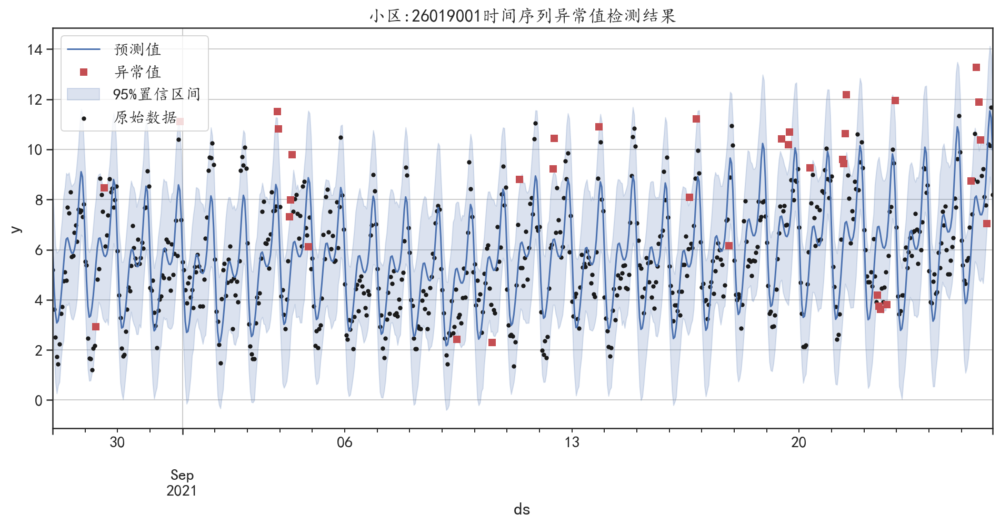

Initial log joint probability = -10.1021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1665.67   1.51109e-05       64.5753      0.2198      0.2198      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1665.68   6.77103e-06       74.5389   8.208e-08       0.001      204  LS failed, Hessian reset 
     144       1665.68   1.49099e-08       75.0703      0.0856       0.382      229   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019002   异常值的数量为: 38


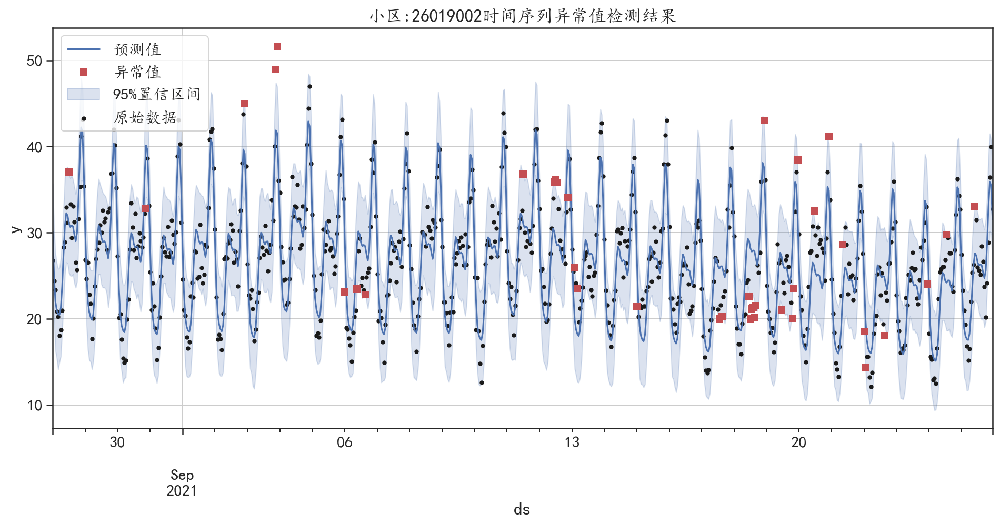

Initial log joint probability = -16.1202
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       1235.61    0.00139449       154.099   1.521e-05       0.001      102  LS failed, Hessian reset 
      99       1235.91    0.00273097        70.317           1           1      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1236.23   0.000497332       61.7732   7.306e-06       0.001      224  LS failed, Hessian reset 
     199       1236.55   1.05246e-05       70.2324      0.4468      0.4468      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1236.55   1.01248e-06       72.1325   1.536e-08       0.001      418  LS failed, Hessian reset 
     236       1236.55   9.25902e-08        62.382      0.1723           1      430   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

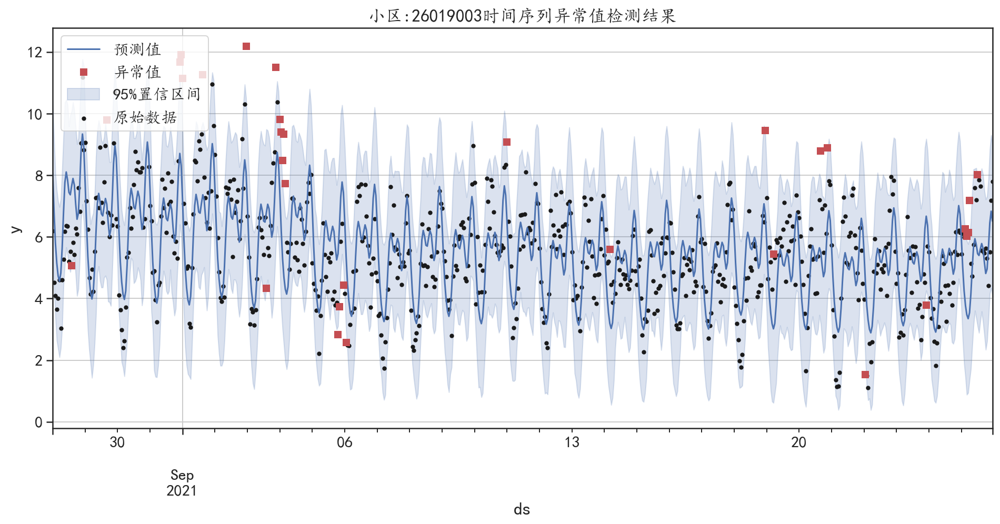

Initial log joint probability = -16.714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1243.84   6.84863e-06       61.7659           1           1      145   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1244.18    0.00114975       94.4238     1.5e-05       0.001      271  LS failed, Hessian reset 
     199       1244.41   5.24026e-05       73.2198      0.3835      0.3835      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1244.43    9.6596e-06       86.3621           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1244.46   7.81983e-09       63.6025     0.06355      0.9397      553   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
小区: 26019004   异常值的数量为: 32


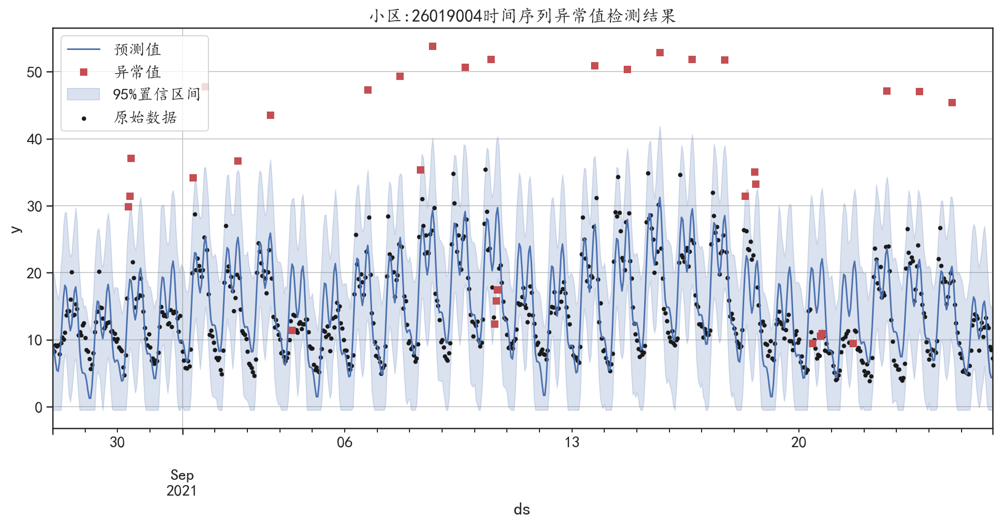

Initial log joint probability = -32.8427
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.85    0.00166816       83.4561           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     179       1356.53   0.000162473       77.5984   2.582e-06       0.001      276  LS failed, Hessian reset 
     199       1356.54   1.38495e-05       84.9198      0.6384      0.6384      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1356.56   3.34127e-06       54.0073   4.784e-08       0.001      369  LS failed, Hessian reset 
     261       1356.57   2.10543e-05       73.9325   3.224e-07       0.001      455  LS failed, Hessian reset 
     299       1356.57   1.06392e-06       64.9042      0.7121      0.7121      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

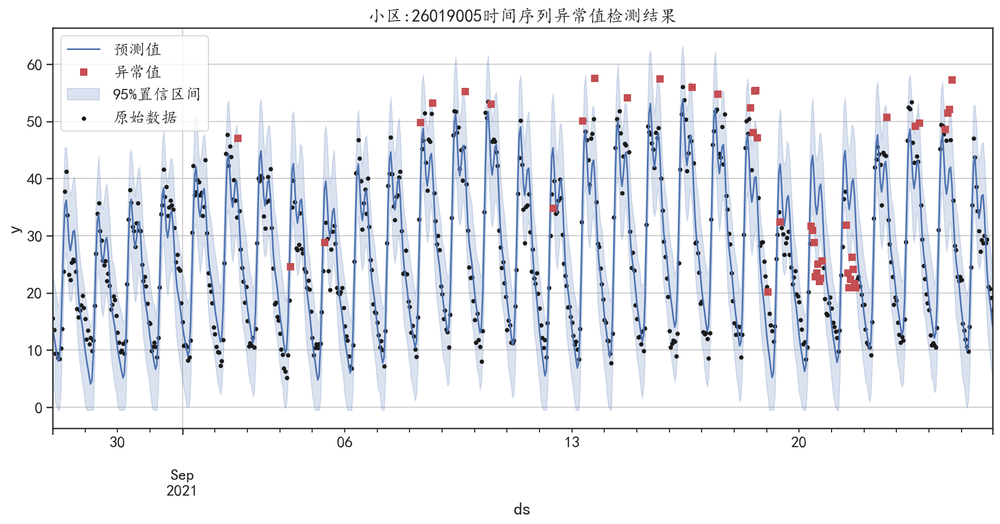

Initial log joint probability = -25.0319
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1230.53   0.000591093        90.279           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1230.72   0.000317865       52.6359   3.866e-06       0.001      269  LS failed, Hessian reset 
     199       1230.86   5.90223e-06        73.339      0.1213           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1230.86   1.25289e-07       65.3868      0.2123           1      375   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019006   异常值的数量为: 46


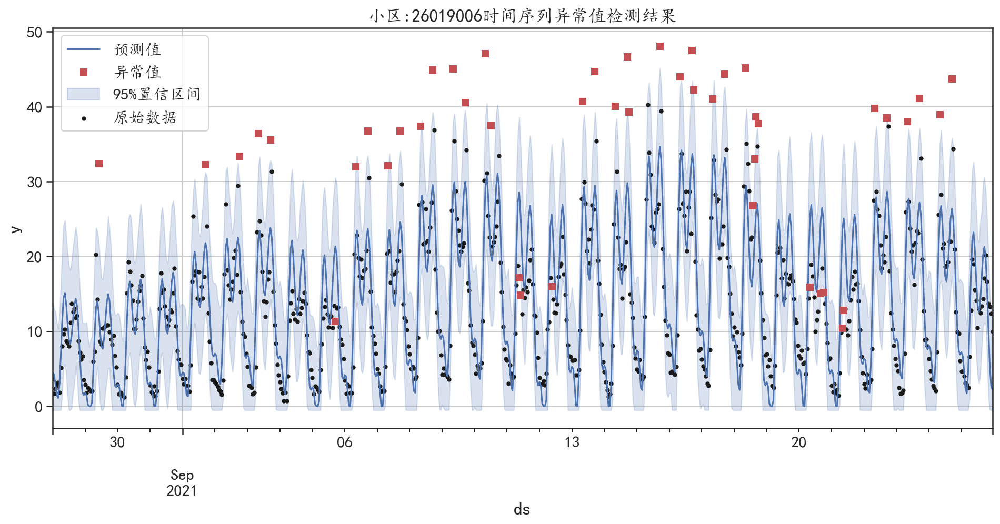

Initial log joint probability = -9.89945
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1491.57   0.000907743       114.967           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       1491.85   0.000258062       75.6505   2.816e-06       0.001      194  LS failed, Hessian reset 
     199       1492.01   8.17498e-05       67.8251      0.2193      0.2193      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     289       1492.48    1.0099e-07       57.2788      0.3975           1      395   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019007   异常值的数量为: 33


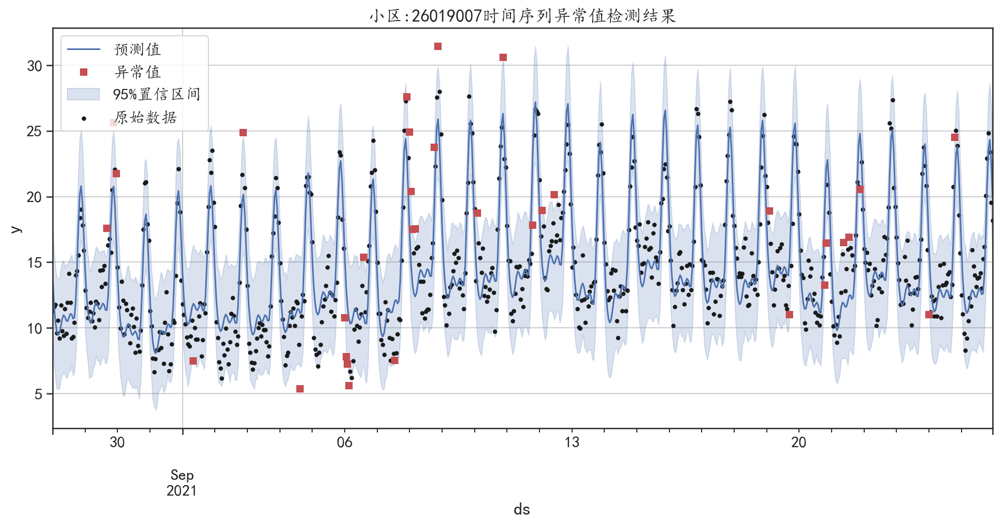

Initial log joint probability = -10.5983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1404.78   0.000431619       89.0976   3.551e-06       0.001      205  LS failed, Hessian reset 
      99       1404.82   0.000652859       73.8344           1           1      207   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     184       1404.97   2.90576e-06       67.0254   4.203e-08       0.001      366  LS failed, Hessian reset 
     199       1404.97   1.45266e-07       62.7546      0.6752      0.6752      390   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1404.97   1.79207e-08       61.0192       0.216       0.216      397   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019008   异常值的数量为: 31


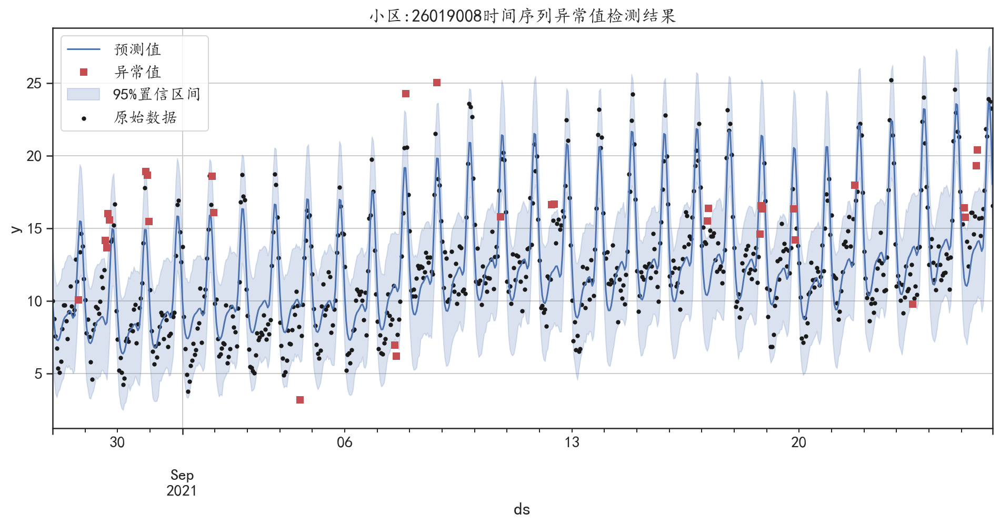

Initial log joint probability = -35.0568
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       902.258    0.00348396       89.4195   3.588e-05       0.001      120  LS failed, Hessian reset 
      99       902.424   4.72416e-06       71.7274      0.2976      0.2976      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       902.527   1.81757e-05       74.0284      0.4554      0.4554      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       902.539   2.95059e-06       75.2342           1           1      419   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        902.56     2.506e-07       70.1503      0.5793      0.5793      545   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     440        902.56   3.76361e-06    

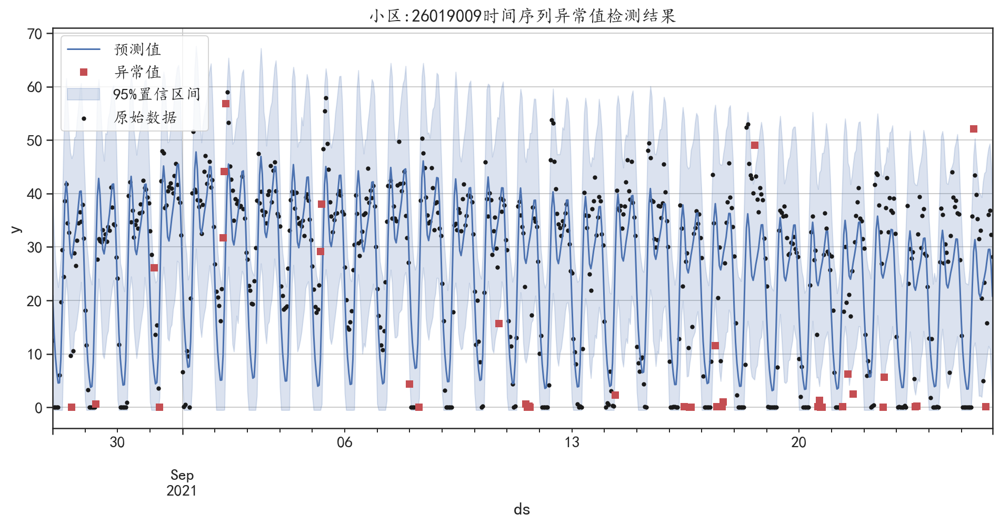

Initial log joint probability = -10.4101
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1128.6   0.000306573       83.7598      0.4665           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1129.15   4.41284e-05       84.1581      0.1782           1      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1129.15   2.55137e-08       76.2364     0.04549      0.4854      312   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019010   异常值的数量为: 31


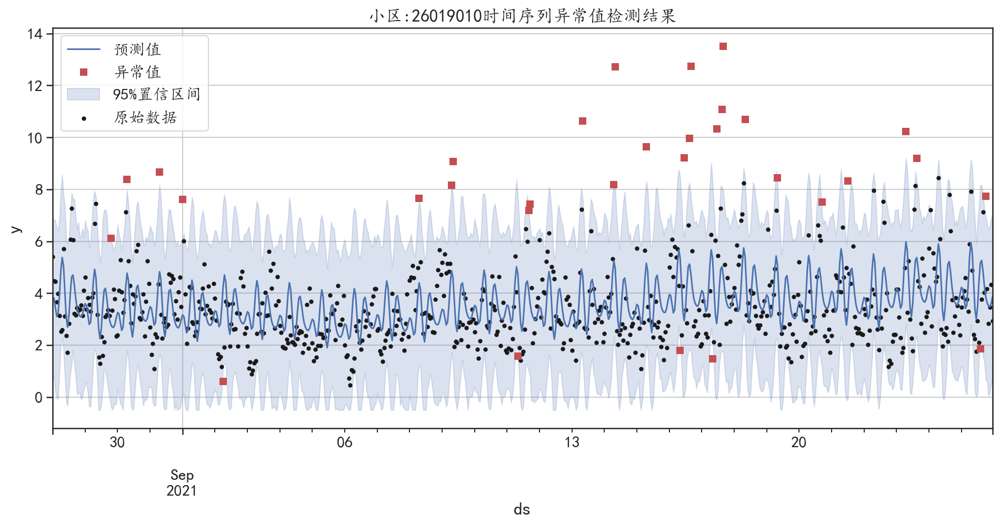

Initial log joint probability = -12.0811
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83        1485.7   5.27755e-08       77.4273      0.4868      0.4868      106   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019011   异常值的数量为: 39


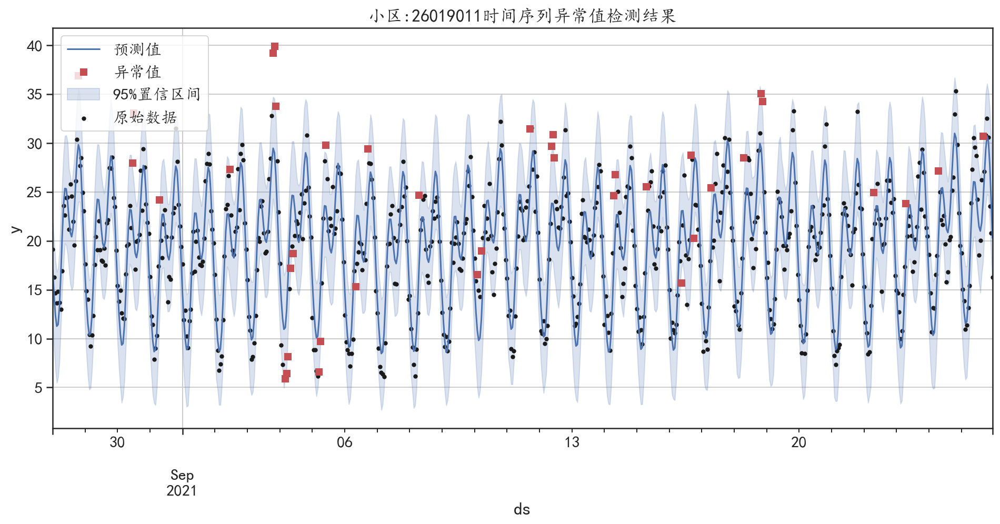

Initial log joint probability = -19.5399
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1235.54    0.00412211       80.4745           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1236.56   5.25818e-06       73.5033      0.4874      0.4874      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       1236.56    9.9309e-06       83.9182   1.403e-07       0.001      329  LS failed, Hessian reset 
     260       1236.56   7.82462e-08       73.5542      0.3676           1      364   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019012   异常值的数量为: 44


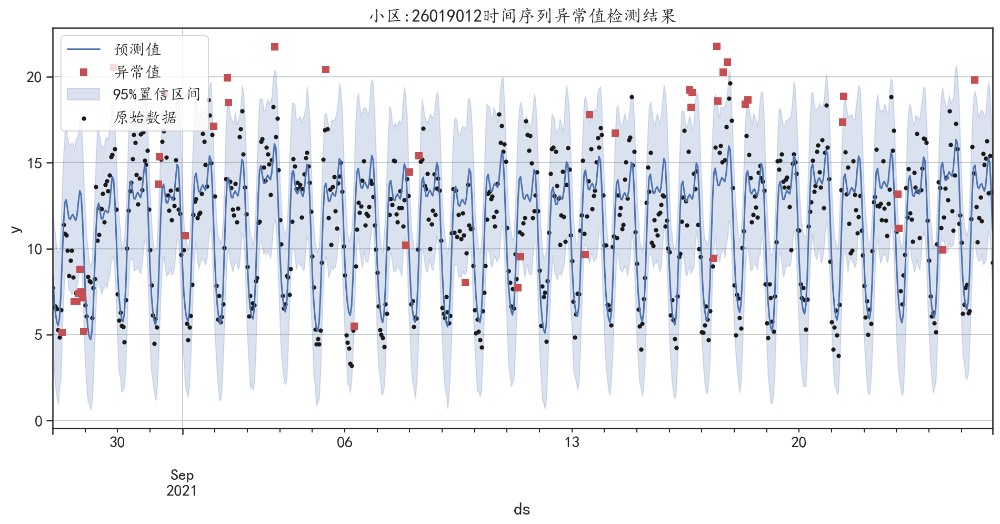

Initial log joint probability = -33.7472
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1299.85   0.000603061       92.7981      0.6224      0.6224      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     195       1299.92   8.89962e-05        60.708   9.152e-07       0.001      301  LS failed, Hessian reset 
     199       1299.92   3.82829e-05       79.9361      0.2138      0.8591      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1299.92   8.50499e-09       63.2425      0.1093      0.1093      359   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
小区: 26019013   异常值的数量为: 56


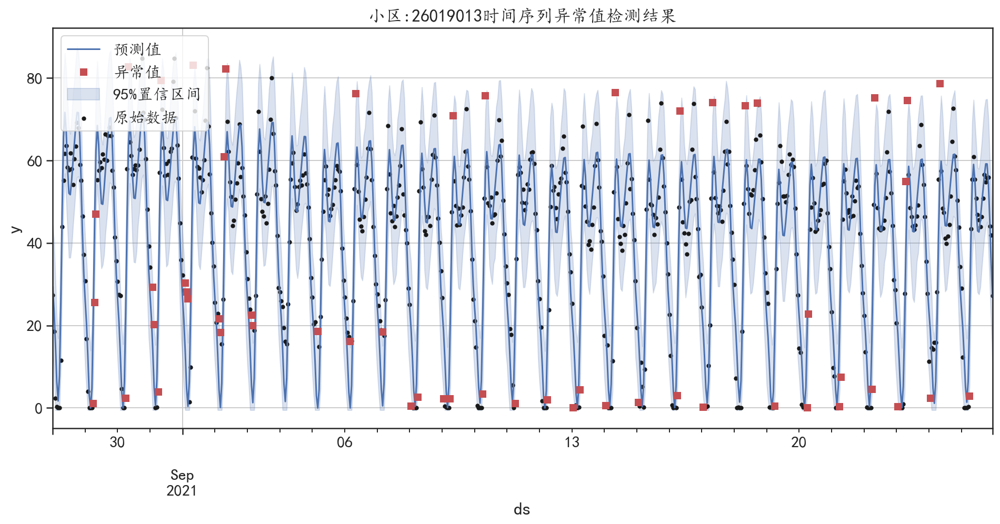

Initial log joint probability = -11.1058
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      95       1529.16    0.00160201       274.476   1.286e-05       0.001      159  LS failed, Hessian reset 
      99       1529.34   0.000926284       110.956           1           1      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1529.43   7.86699e-08       80.6066           1           1      228   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019014   异常值的数量为: 41


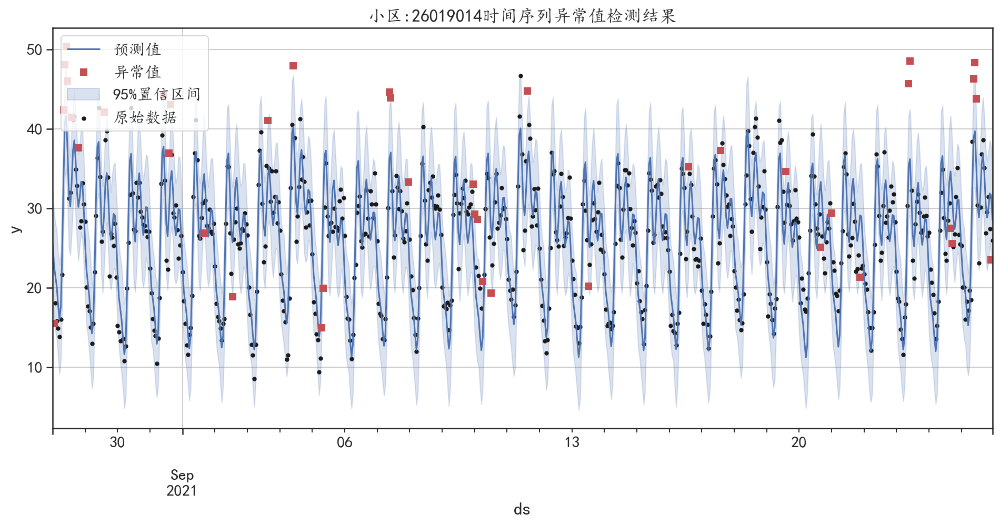

Initial log joint probability = -11.2895
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1344.39   0.000522611       86.5982           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1344.43   4.91434e-08       86.1431      0.1836      0.9157      184   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019015   异常值的数量为: 42


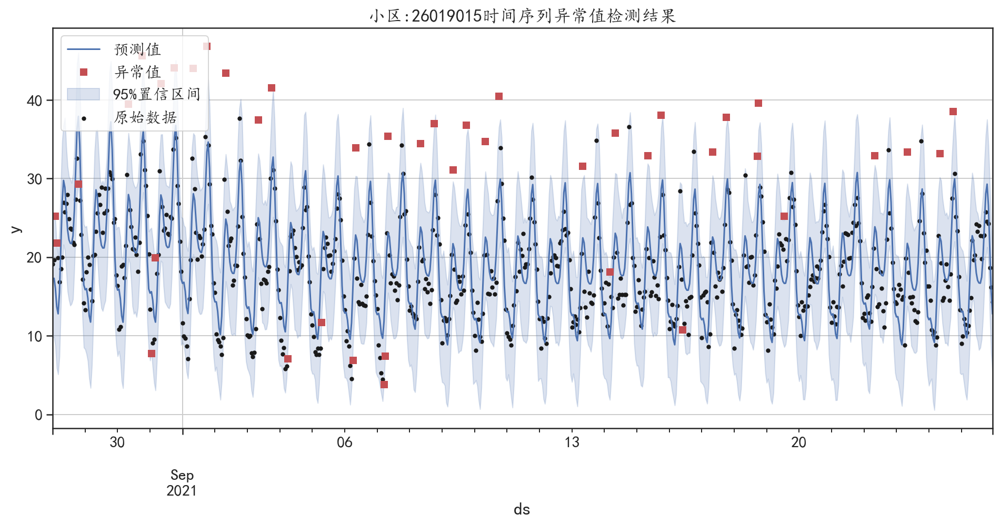

Initial log joint probability = -27.7811
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1567.68   9.14326e-06       44.5046      0.8504     0.08504      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173       1567.76   6.11978e-06       71.4745    9.41e-08       0.001      267  LS failed, Hessian reset 
     199       1567.76   7.07494e-07       63.8392      0.6458      0.6458      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1567.76    1.3369e-07        42.838      0.2544           1      329   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019016   异常值的数量为: 46


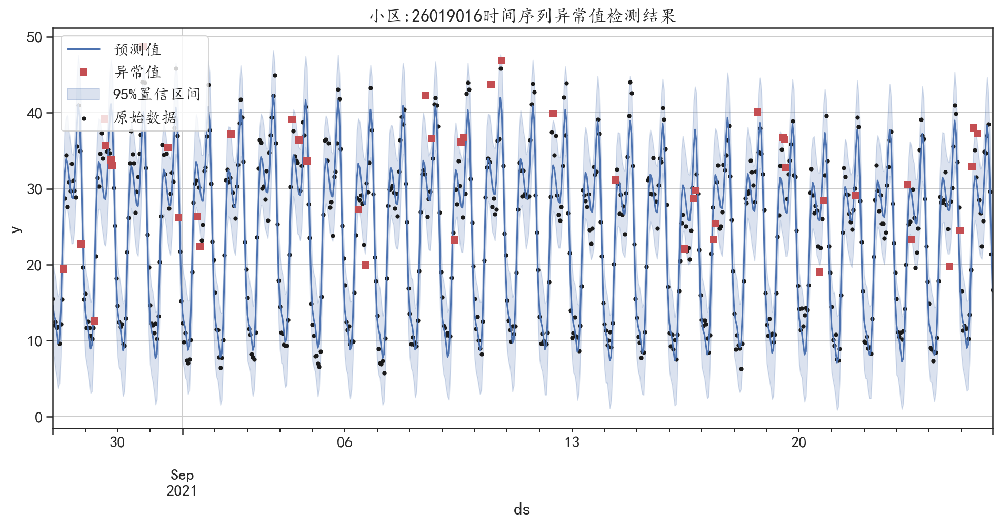

Initial log joint probability = -15.6055
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1495.63   5.65913e-06       57.8698     0.04784           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       1495.67   0.000117662       69.6702   1.652e-06       0.001      217  LS failed, Hessian reset 
     178       1495.69   6.31609e-08       52.1264       0.214           1      279   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019017   异常值的数量为: 41


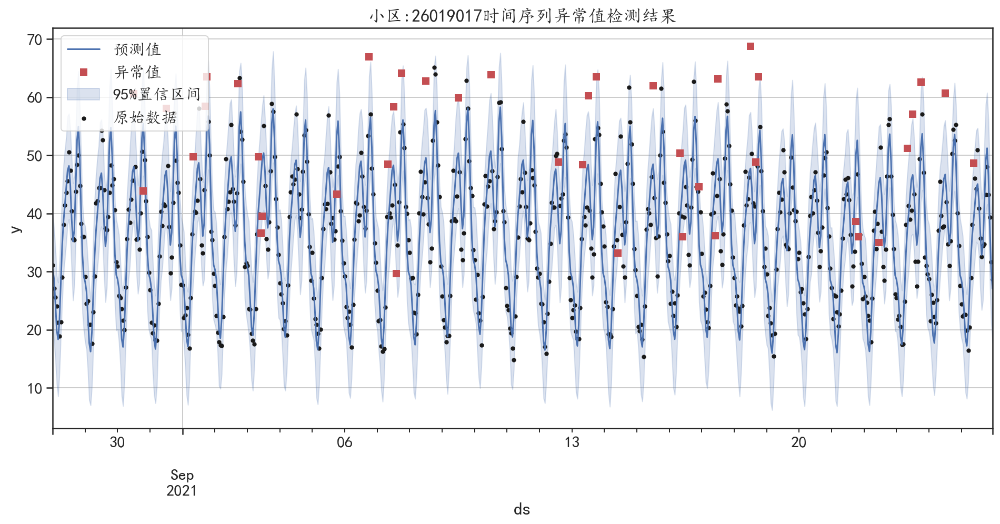

Initial log joint probability = -17.0451
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1298.97    1.3209e-06        66.197      0.3333           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1298.97   9.73292e-08       74.6312      0.3846           1      183   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019018   异常值的数量为: 34


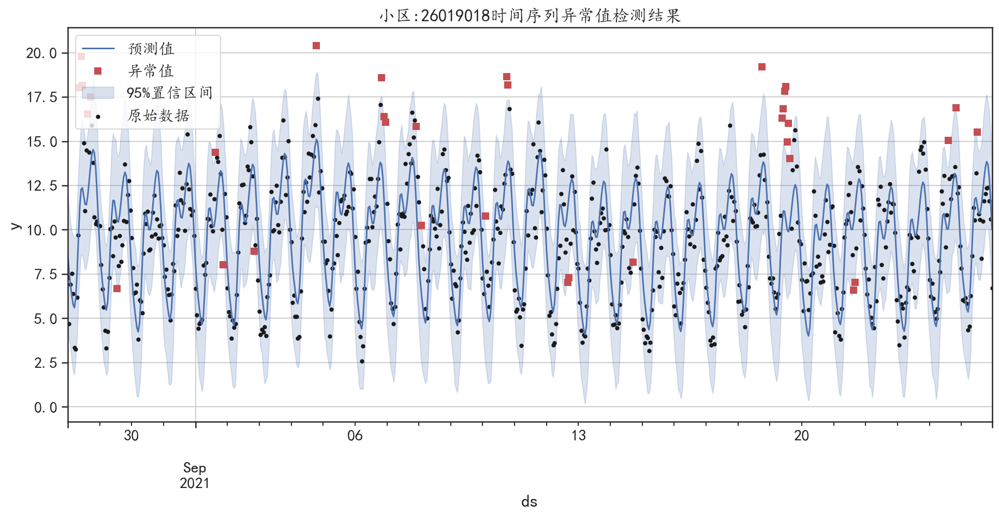

Initial log joint probability = -15.0598
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76       1459.77   0.000744461       157.571   6.379e-06       0.001      130  LS failed, Hessian reset 
      99       1460.45   0.000569347       83.3901           1           1      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1460.87    0.00132741       124.407   1.455e-05       0.001      238  LS failed, Hessian reset 
     199       1461.06   9.58074e-07       75.0771      0.6074      0.6074      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1461.06   3.87423e-08       72.3834      0.1936           1      361   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019019   异常值的数量为: 41


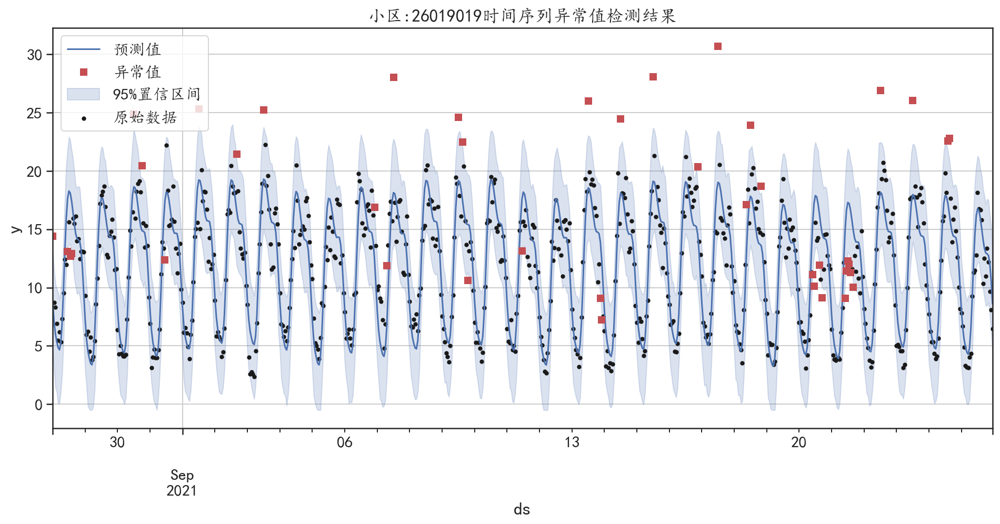

Initial log joint probability = -61.0439
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1233.3    0.00201436       100.591     0.09553      0.2186      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1233.32   0.000461602       91.5856   4.589e-06       0.001      155  LS failed, Hessian reset 
     199       1233.54   4.00036e-06       62.7905      0.3138           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1233.54   7.59886e-11       83.6098    6.98e-06           1      320   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
小区: 26019020   异常值的数量为: 40


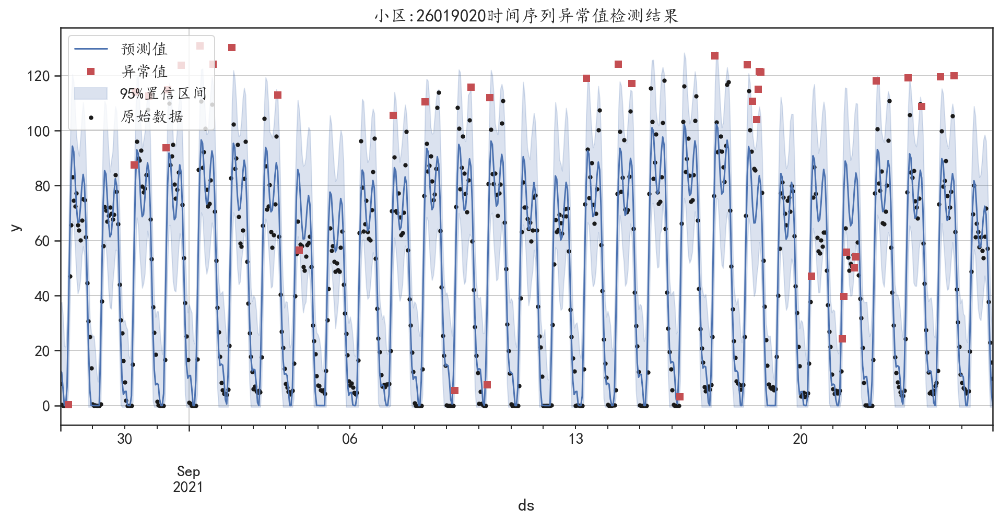

Initial log joint probability = -44.2173
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1269.73   0.000257776       69.0078   2.558e-06       0.001      136  LS failed, Hessian reset 
      99       1269.76   1.18652e-05       77.5981      0.8401      0.8401      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1269.76   4.81286e-05       80.2189   6.656e-07       0.001      202  LS failed, Hessian reset 
     135       1269.77   1.52844e-07       53.5957      0.2881           1      244   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019021   异常值的数量为: 44


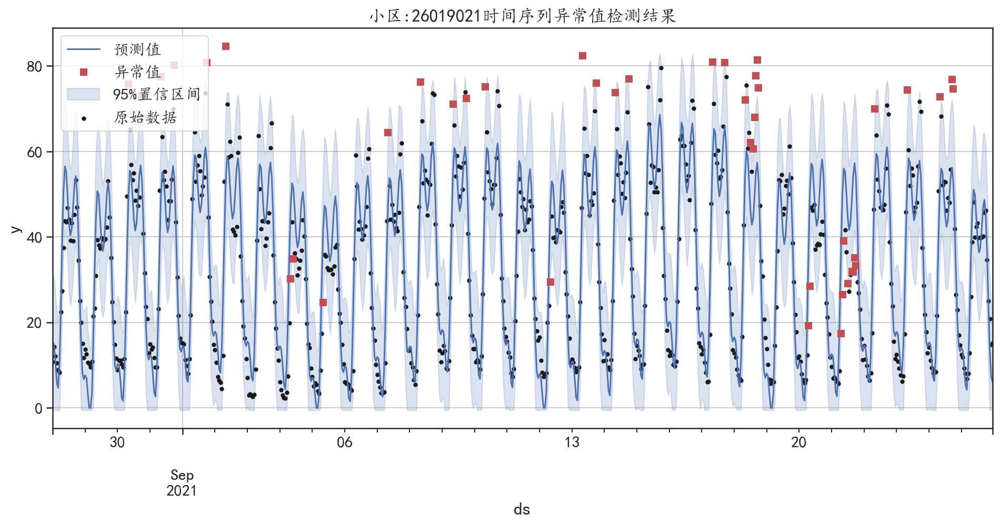

Initial log joint probability = -32.5819
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       1495.22   0.000647364       101.171   8.796e-06       0.001      159  LS failed, Hessian reset 
      99       1495.29     0.0021532       148.714           1           1      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     197        1495.7   0.000678716       183.611   6.151e-06       0.001      317  LS failed, Hessian reset 
     199       1495.76   0.000761829       103.407           1           1      319   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1496.04   7.91775e-06       82.9311   9.435e-08       0.001      434  LS failed, Hessian reset 
     299       1496.04   5.19052e-06       82.7274      0.7133      0.7133      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

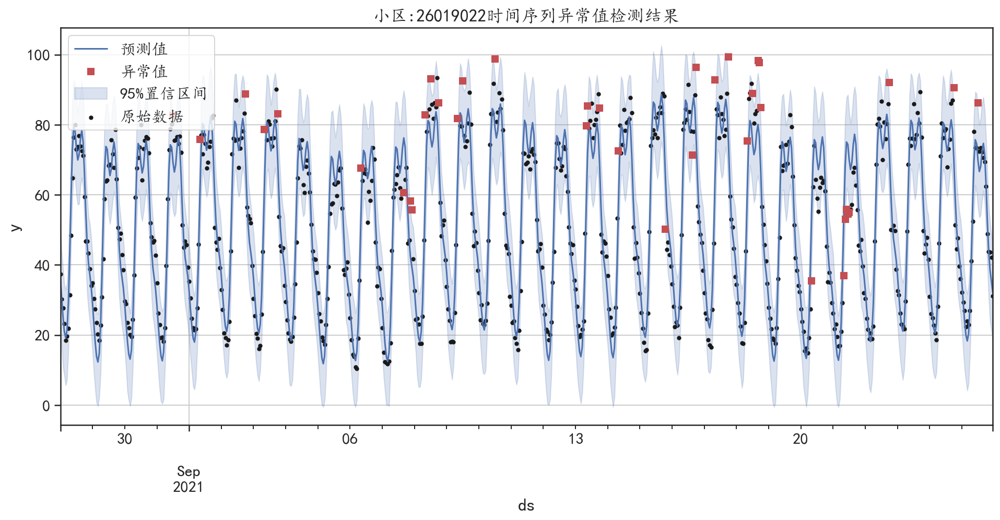

Initial log joint probability = -25.6451
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1567.49     0.0037398       105.115      0.5775      0.5775      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       1573.18   0.000222932        164.16    1.79e-06       0.001      256  LS failed, Hessian reset 
     199       1573.66    0.00089305       85.0137           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1573.72    7.7738e-05       77.2655   9.179e-07       0.001      388  LS failed, Hessian reset 
     299       1573.73   1.18991e-06       62.3466       0.577       0.577      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1574.05   1.43512e-05       78.9451           1           1      576   
    Iter      log pro

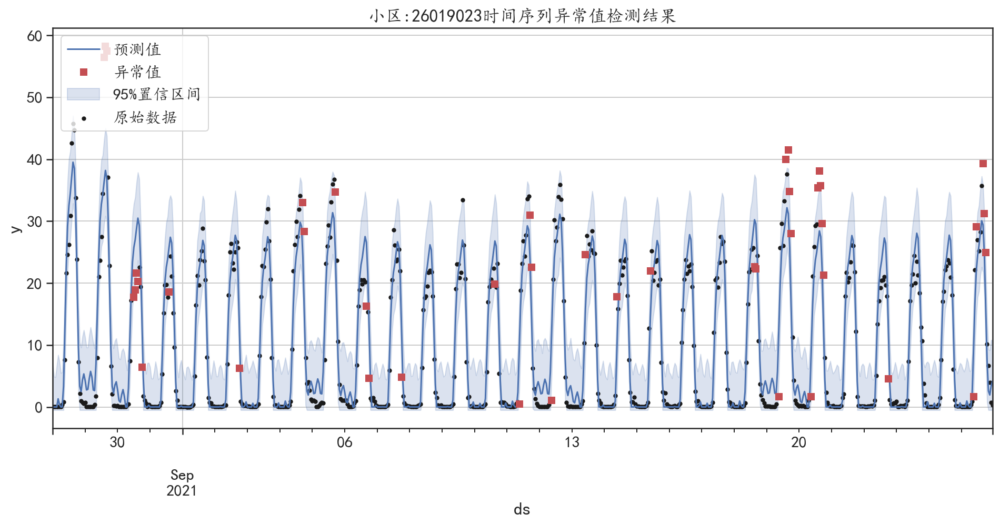

Initial log joint probability = -26.9075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1681.46    0.00124621       105.616      0.9092      0.9092      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1686.75   0.000886861       58.7837      0.2914           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1686.85   0.000143262       89.5065   2.011e-06       0.001      303  LS failed, Hessian reset 
     256       1686.99   4.98456e-05       74.4494   7.936e-07       0.001      406  LS failed, Hessian reset 
     299          1687   0.000129947       76.4204           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     343       1687.59   7.57831e-05       84.5917   7.921e-07       0.001      557  LS failed, Hessian rese

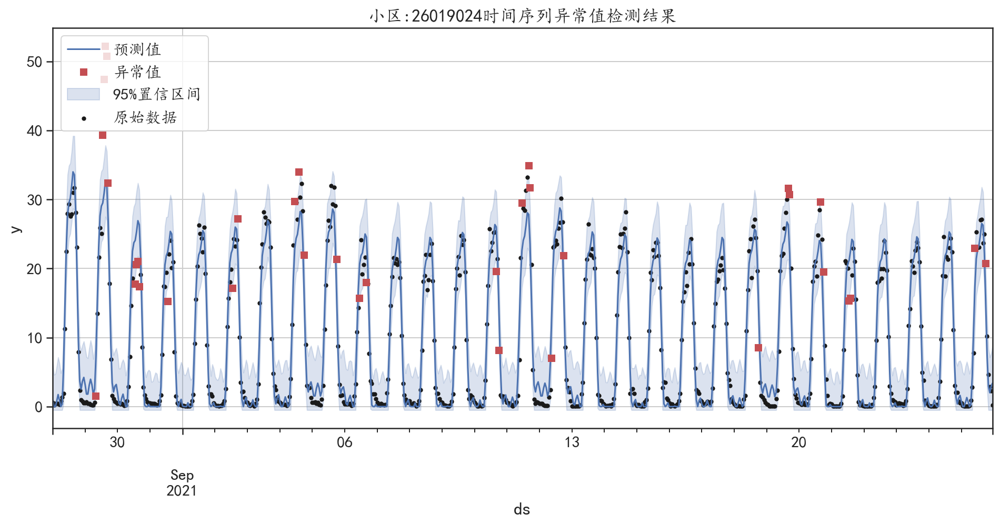

Initial log joint probability = -12.4949
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1538.53   0.000273136       64.4189   1.971e-06       0.001      132  LS failed, Hessian reset 
      99       1539.49   0.000273168       53.3678           1           1      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1540.82    0.00156107       66.2256           1           1      309   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1540.84   1.21719e-05        71.761   2.223e-07       0.001      380  LS failed, Hessian reset 
     246       1540.84   1.10861e-07       54.6599     0.03323           1      413   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019025   异常值的数量为: 28


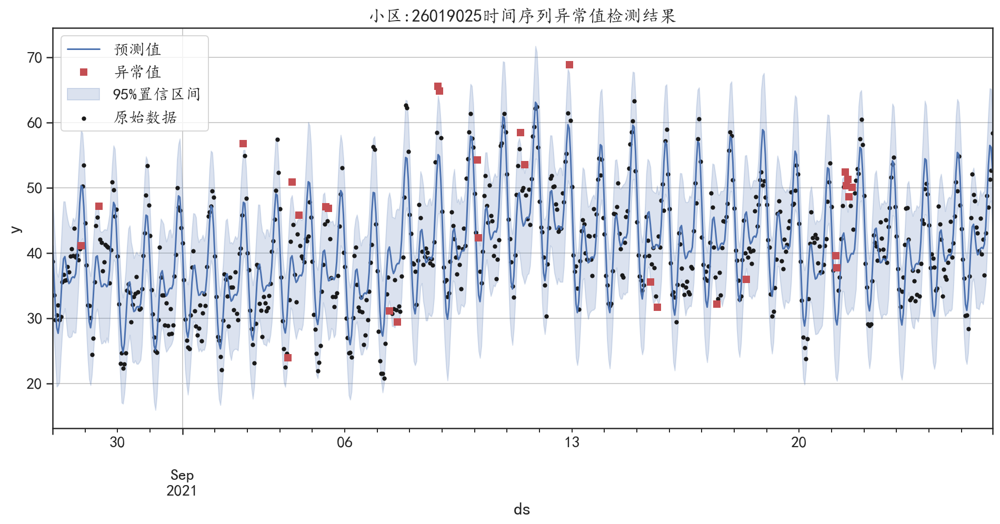

Initial log joint probability = -19.4538
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1429.29   0.000902096       82.4522     0.02692           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100        1429.3   0.000690673       132.011   8.377e-06       0.001      183  LS failed, Hessian reset 
     155       1429.45   0.000332086       90.1544   3.749e-06       0.001      289  LS failed, Hessian reset 
     191       1429.46   8.45883e-07       75.7121   1.139e-08       0.001      373  LS failed, Hessian reset 
     199       1429.46   1.98895e-07       57.2947           1           1      385   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1429.46   1.23047e-07       62.3088           1           1      389   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

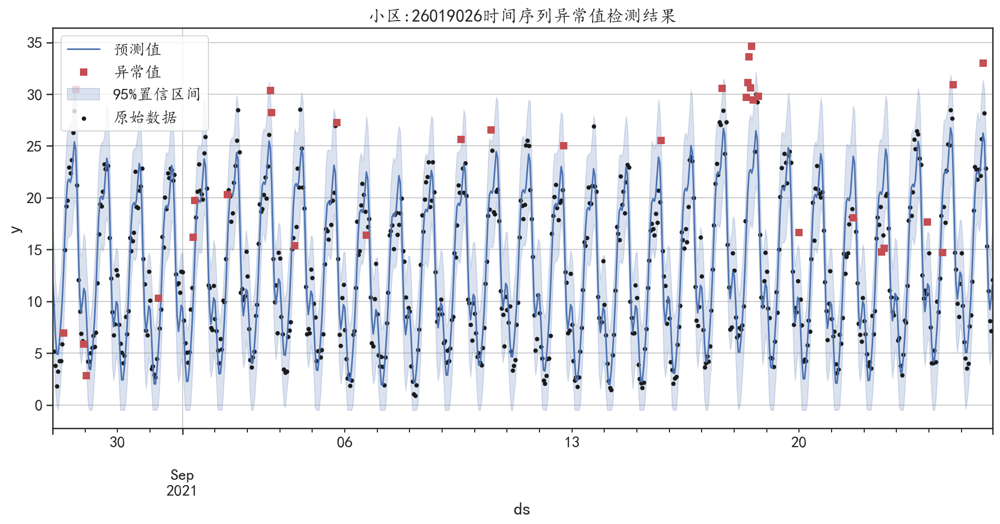

Initial log joint probability = -24.1425
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.55   0.000386311       55.6255           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1436.81   0.000124501       60.3909   1.482e-06       0.001      218  LS failed, Hessian reset 
     199       1436.91    0.00943054       100.561      0.6177           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1436.93   0.000392142       90.4236   4.334e-06       0.001      347  LS failed, Hessian reset 
     281       1437.03   7.60856e-08       57.0731      0.2619           1      465   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019027   异常值的数量为: 36


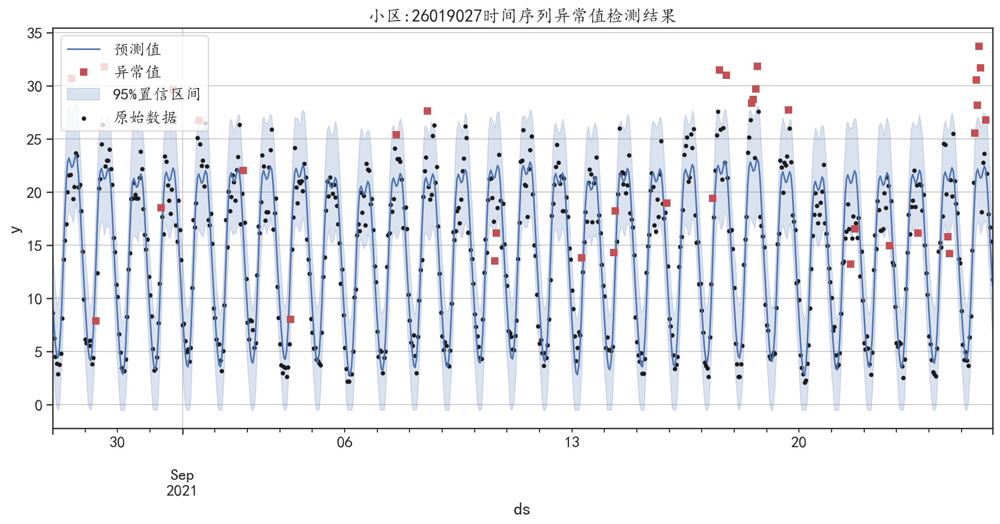

Initial log joint probability = -33.2032
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1488.03    0.00399299       87.1913           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1488.08     0.0011511       210.872   1.293e-05       0.001      170  LS failed, Hessian reset 
     199       1488.32   8.94089e-05       70.2872      0.8859      0.8859      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1488.37    0.00016959       69.9199   2.792e-06       0.001      361  LS failed, Hessian reset 
     299       1488.45    0.00010327       76.2213      0.8461      0.8461      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     387        1488.5   2.38934e-05       71.7848   3.733e-07       0.001      643  LS failed, Hessian rese

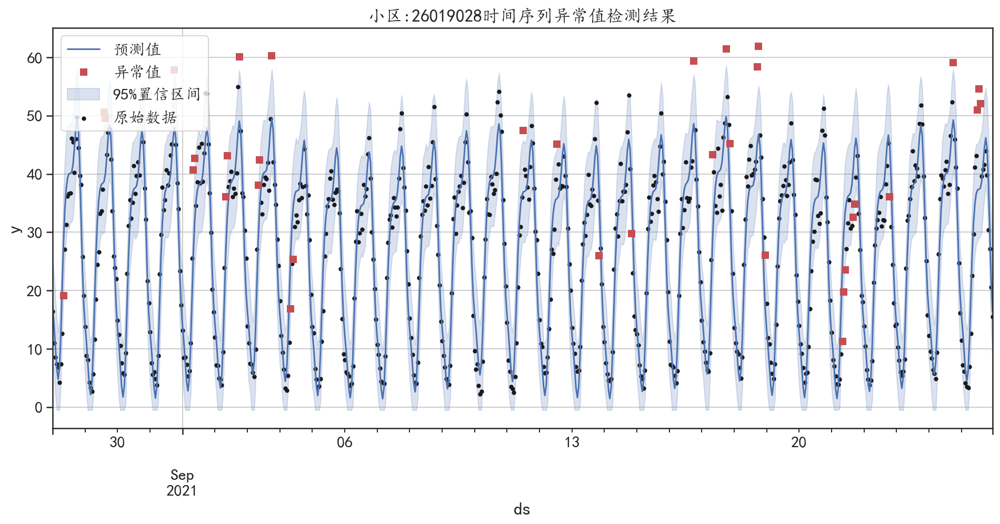

Initial log joint probability = -35.7244
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1184.03   9.99524e-06       59.8982           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       1184.05   1.15068e-07       60.0436      0.1733      0.7148      284   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019029   异常值的数量为: 43


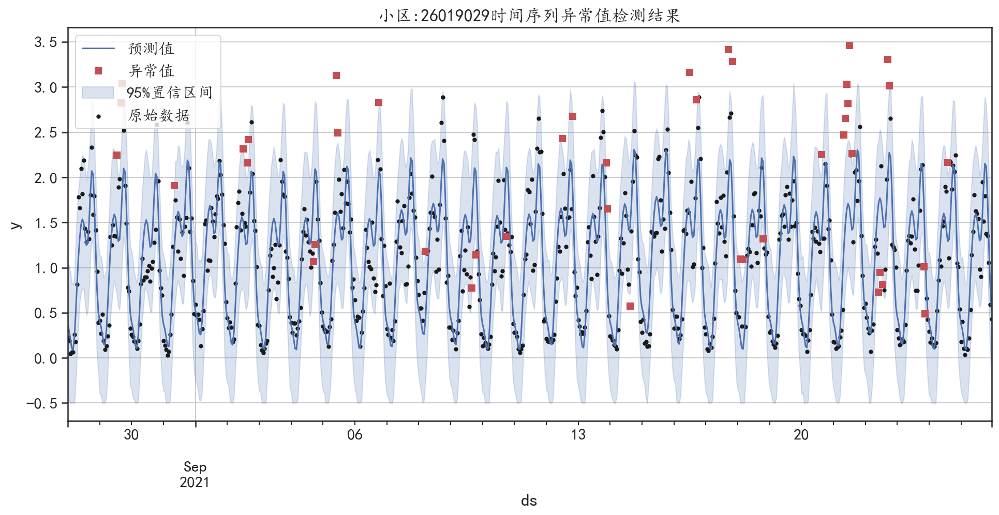

Initial log joint probability = -9.15875
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1346.07   0.000115748        65.355           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1346.37   1.30919e-06       70.5859           1           1      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212       1346.37   5.22194e-06       70.1849   7.985e-08       0.001      323  LS failed, Hessian reset 
     247       1346.37   3.45706e-08       54.0952      0.2869           1      375   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019030   异常值的数量为: 36


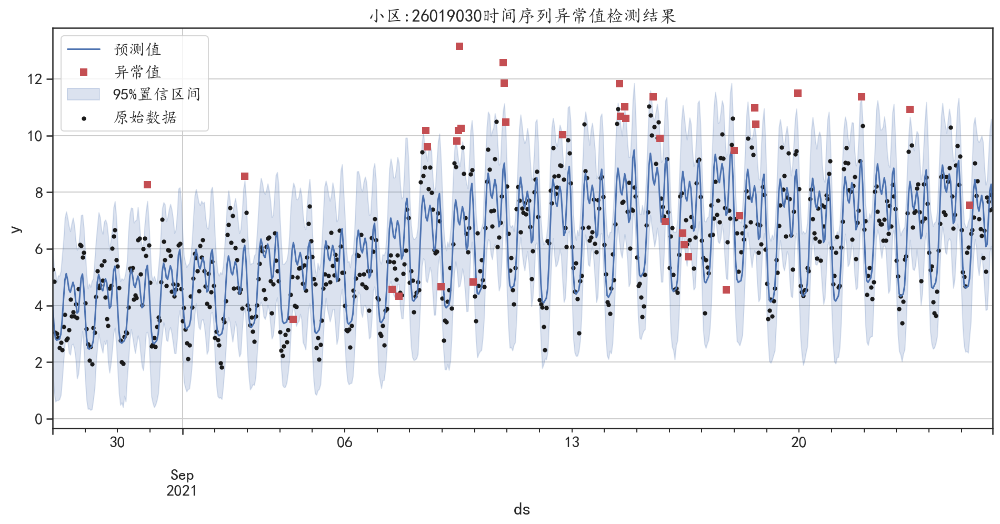

Initial log joint probability = -19.7658
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1416.33   0.000261521       85.1998           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1416.43   0.000571183       90.2766   6.731e-06       0.001      174  LS failed, Hessian reset 
     175       1416.51   0.000394073       64.1815   4.166e-06       0.001      306  LS failed, Hessian reset 
     199       1416.53   6.46362e-05       76.2014           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1416.53    4.2387e-06       50.2193   5.656e-08       0.001      382  LS failed, Hessian reset 
     299       1416.54   2.61443e-06       76.3706           1           1      504   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

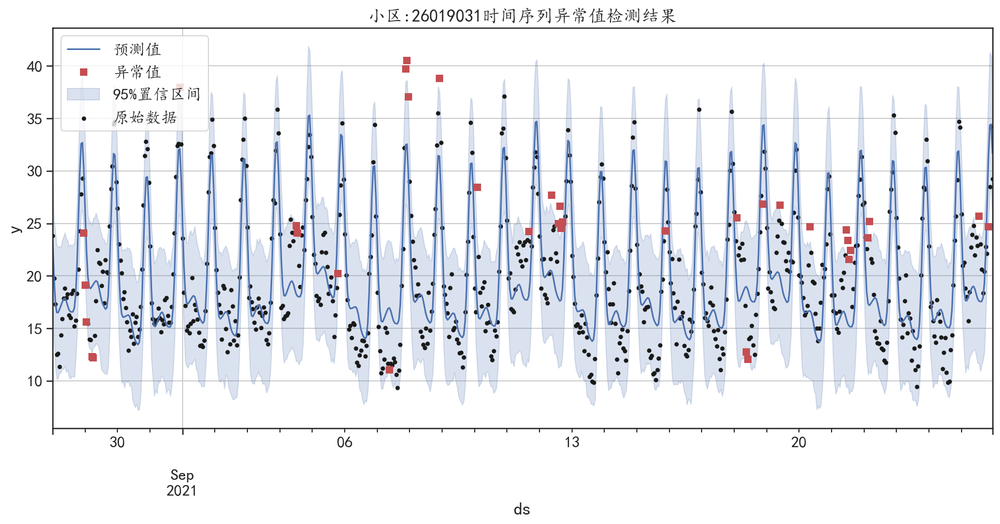

Initial log joint probability = -12.9983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      75       1292.03   0.000858073       116.944   1.187e-05       0.001      134  LS failed, Hessian reset 
      99       1292.12   0.000310202       57.8494      0.8821      0.8821      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1292.13   0.000136037       78.7073   2.208e-06       0.001      224  LS failed, Hessian reset 
     199       1292.28    0.00114757       72.5885      0.8323      0.8323      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1292.39   1.29437e-05       66.5657      0.6233           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     311       1292.39   1.62572e-06       62.6101   2.831e-08       0.001      531  LS failed, Hessian rese

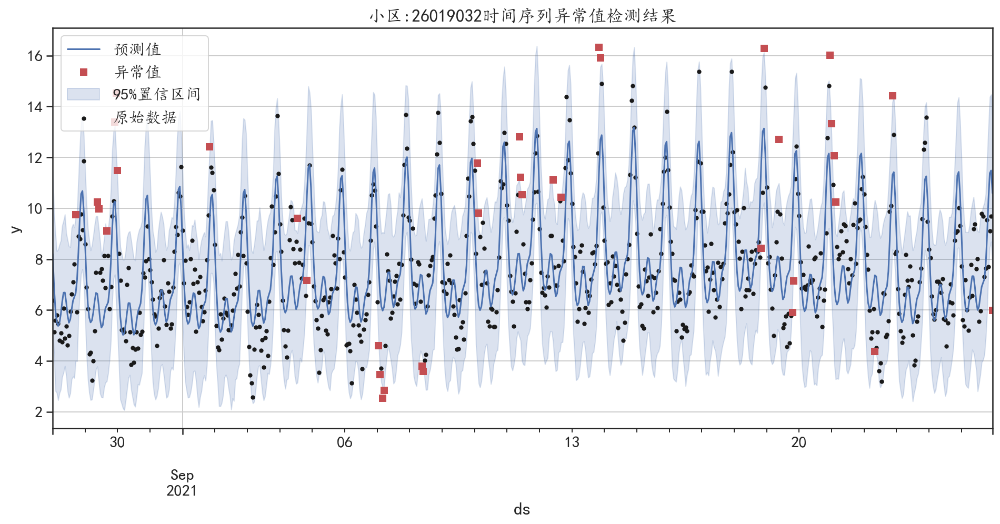

Initial log joint probability = -14.2273
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1360.6   0.000802148       94.6413      0.5669      0.5669      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173          1361   0.000156316       87.2494   1.891e-06       0.001      256  LS failed, Hessian reset 
     199       1361.01    1.0476e-05       98.7914       0.386           1      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1361.02   1.46382e-05       88.1814   1.655e-07       0.001      384  LS failed, Hessian reset 
     264       1361.02   5.76822e-08       86.3942      0.5501      0.5501      425   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019033   异常值的数量为: 32


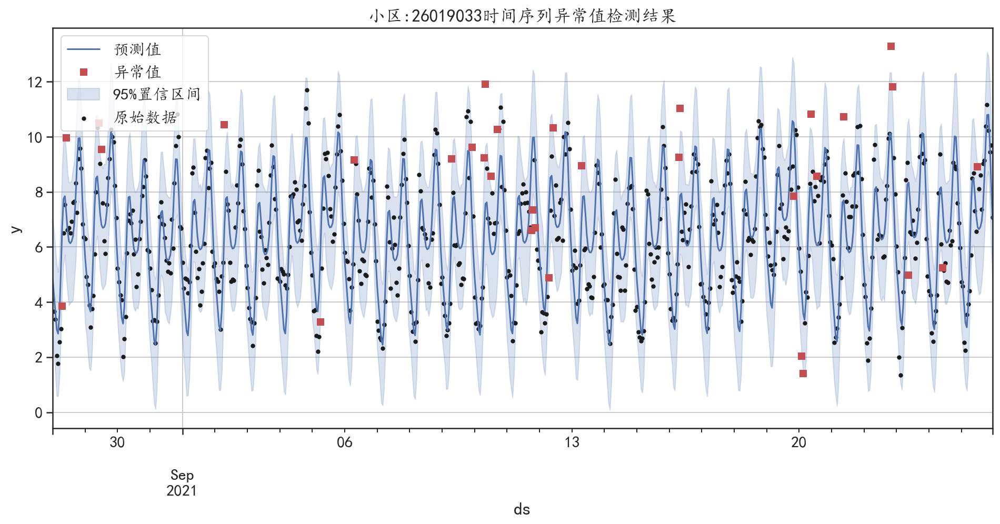

Initial log joint probability = -22.3655
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1252.19   0.000298403       100.725           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1252.26   0.000482029       78.8117   5.679e-06       0.001      180  LS failed, Hessian reset 
     199        1252.3   2.35415e-06       78.6009      0.5056      0.5056      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1252.31   0.000125196       78.6701   1.409e-06       0.001      334  LS failed, Hessian reset 
     267       1252.31    1.5594e-06       75.3343   2.268e-08       0.001      442  LS failed, Hessian reset 
     275       1252.31   5.75888e-08       58.0743      0.5548      0.5548      454   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

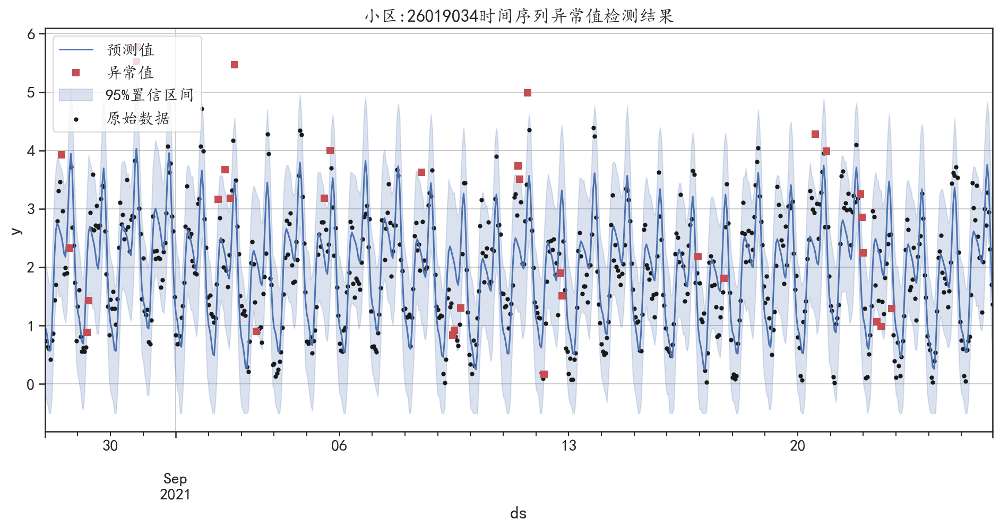

Initial log joint probability = -21.1795
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.08   0.000390746       66.3611      0.3288           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     116       1361.11   8.47954e-05       81.7512   1.193e-06       0.001      189  LS failed, Hessian reset 
     199       1361.15   1.67682e-07       74.8881      0.4289           1      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1361.15    9.2828e-08       75.1407      0.8315      0.8315      296   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019035   异常值的数量为: 40


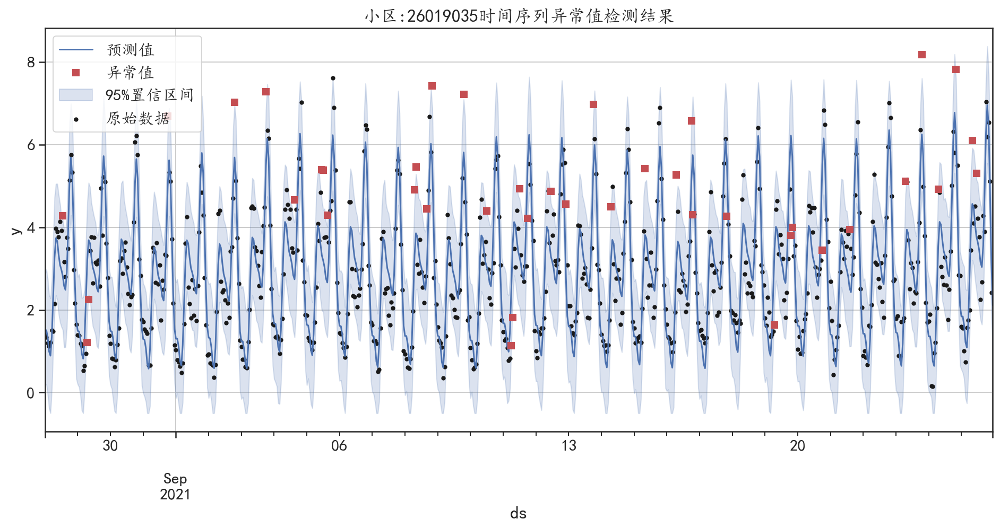

Initial log joint probability = -23.1249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       914.904   5.52012e-06       59.2877     0.09002           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       914.906   6.22561e-06       64.6536   8.346e-08       0.001      198  LS failed, Hessian reset 
     156       914.907      3.08e-06       71.0483   5.398e-08       0.001      294  LS failed, Hessian reset 
     164       914.907   6.37864e-09       47.5865     0.02683     0.02683      307   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
小区: 26019036   异常值的数量为: 33


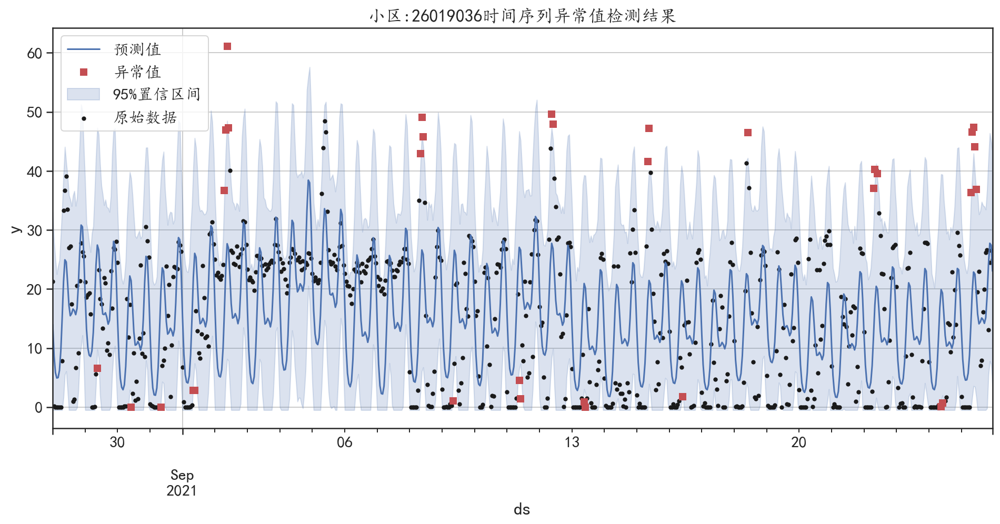

Initial log joint probability = -7.89617
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      72       1280.12    0.00022692       92.0335   2.731e-06       0.001      131  LS failed, Hessian reset 
      99       1280.14   9.34162e-07       73.4125      0.6507      0.6507      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       1280.14   5.97905e-08       68.5729      0.2949      0.8125      186   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019037   异常值的数量为: 34


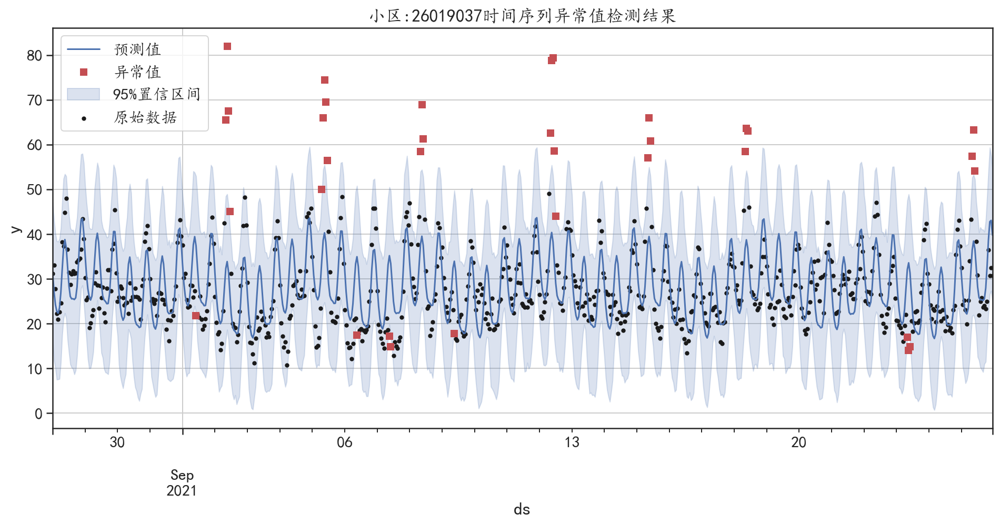

Initial log joint probability = -10.6413
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1272.42    0.00387925       92.9265           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1272.62    0.00226187       92.0635   3.034e-05       0.001      166  LS failed, Hessian reset 
     177       1272.81   5.66523e-08       84.6203      0.3849           1      269   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019038   异常值的数量为: 28


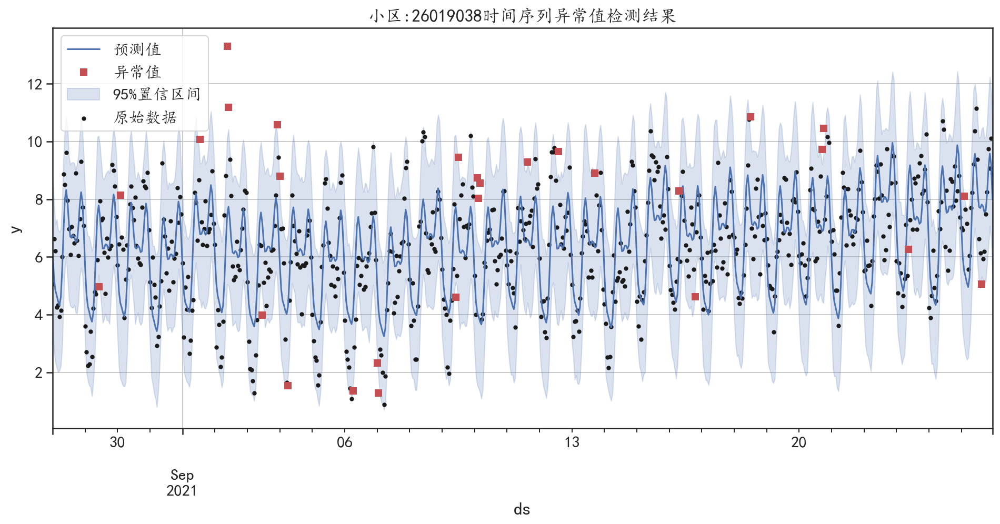

Initial log joint probability = -21.2505
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76       1276.71   0.000300228       84.6401   3.954e-06       0.001      135  LS failed, Hessian reset 
      99       1276.76   1.29633e-05       68.3835      0.8498      0.8498      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1276.89   0.000692502         68.04   7.994e-06       0.001      292  LS failed, Hessian reset 
     199       1276.99   2.21902e-06       71.7902      0.4427      0.4427      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1276.99   6.70455e-06       77.2236    8.84e-08       0.001      389  LS failed, Hessian reset 
     229       1276.99   7.88567e-08       77.1242           1           1      420   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

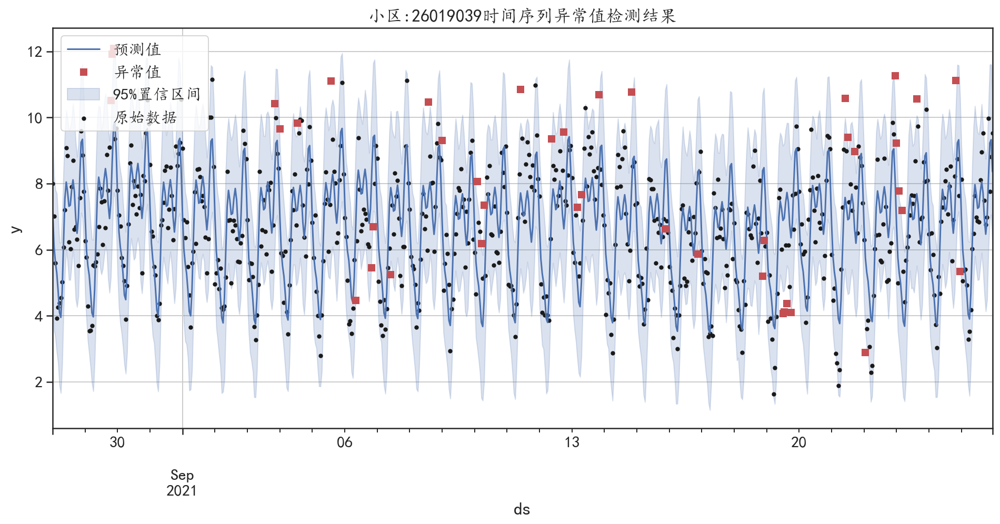

Initial log joint probability = -18.5595
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1655.93   0.000735423       42.9936      0.8232      0.8232      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1656.15   0.000337317       76.8211    5.26e-06       0.001      189  LS failed, Hessian reset 
     181       1656.32   0.000234272       113.402   2.322e-06       0.001      319  LS failed, Hessian reset 
     199       1656.35    3.4267e-06        42.974       0.781       0.781      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245       1656.44   0.000152328       62.3265   2.883e-06       0.001      460  LS failed, Hessian reset 
     299       1656.55   3.91547e-06       48.6466      0.6912      0.6912      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

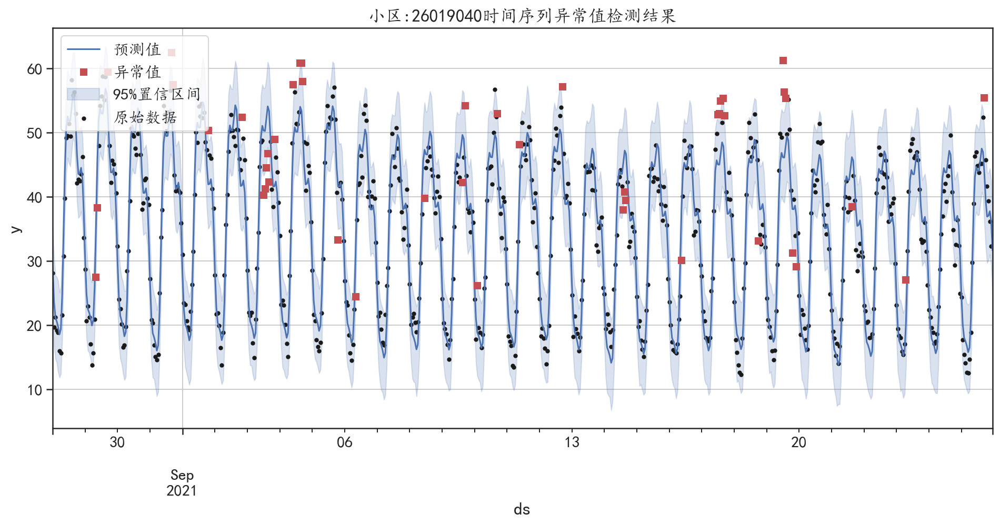

Initial log joint probability = -7.13832
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1401.76    0.00371177       85.2208           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1403.51    0.00120046       188.899   1.179e-05       0.001      281  LS failed, Hessian reset 
     199       1403.98   0.000983054       76.7626        0.46        0.46      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1404.11   1.93737e-07       89.0176     0.07272           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       1404.14   0.000201632       57.9528   2.893e-06       0.001      521  LS failed, Hessian reset 
     384       1404.17   6.16342e-05       97.8499   7.158e-07       0.001      630  LS failed, Hessian rese

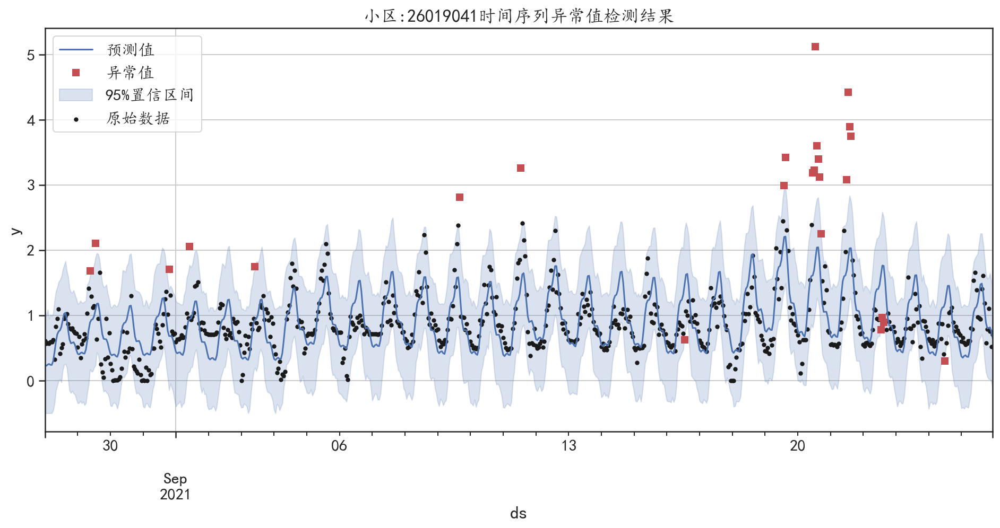

Initial log joint probability = -9.42602
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1421.54    0.00343365       95.8446           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1424   5.75171e-06       74.1957           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1424.06   7.07827e-05       74.6798           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     321       1424.06   2.44747e-07       59.3008           1           1      401   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019042   异常值的数量为: 28


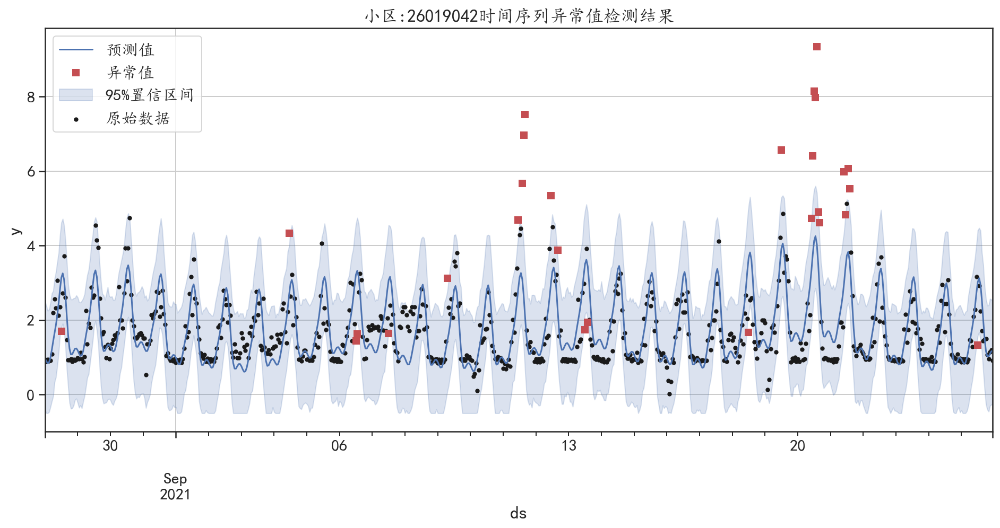

Initial log joint probability = -13.6191
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1122.69   0.000667596       100.029           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       1122.96     0.0018545       74.9685   2.127e-05       0.001      174  LS failed, Hessian reset 
     199        1123.4   1.07281e-06       86.5681      0.3533      0.3533      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1123.68    0.00023506        89.493           1           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1123.68   0.000102498       80.5988   1.053e-06       0.001      441  LS failed, Hessian reset 
     340       1123.69   3.41092e-08       83.5304      0.3566           1      496   
Optimization terminat

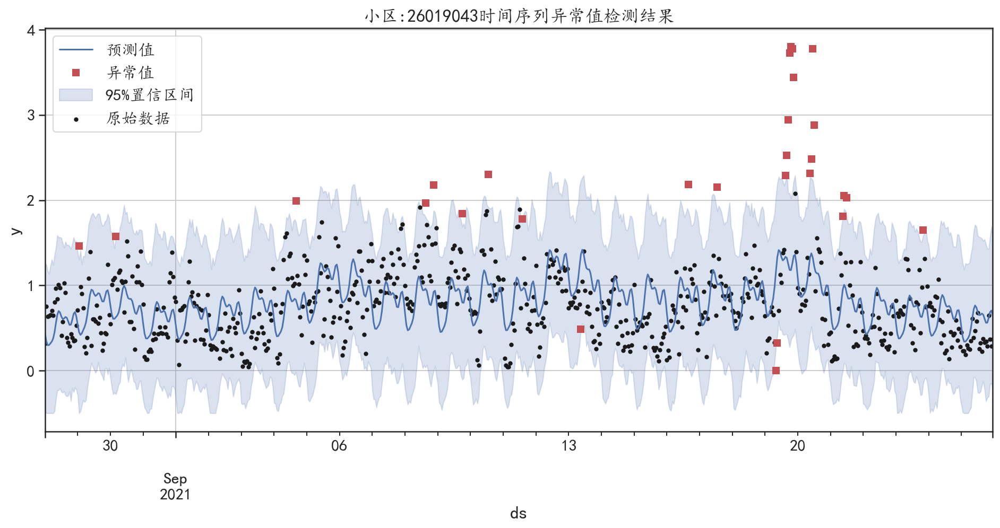

Initial log joint probability = -5.10693
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1554.31    0.00498297       80.5458      0.9748      0.9748      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     151       1558.45   0.000323835       149.001   2.539e-06       0.001      224  LS failed, Hessian reset 
     199       1561.01   0.000588425       83.8278      0.4718      0.4718      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1561.16   6.10536e-05        72.353   7.454e-07       0.001      388  LS failed, Hessian reset 
     299       1561.17   0.000117973        84.834           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1561.34   3.59364e-08       81.2629      0.2389           1      530   
Optimization terminat

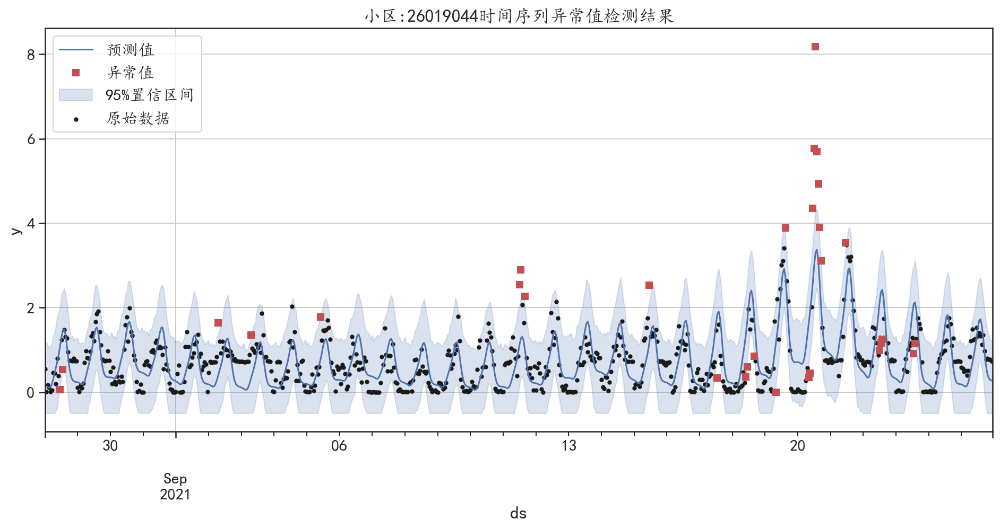

Initial log joint probability = -10.261
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1241.31    0.00326747       82.6159           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       1246.52   0.000659143       152.766   6.545e-06       0.001      214  LS failed, Hessian reset 
     199       1248.26    0.00122147        80.844           1           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248       1248.73   0.000353324        85.192   5.373e-06       0.001      379  LS failed, Hessian reset 
     299       1248.92   8.80987e-07       67.2483      0.7875      0.7875      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1248.92   1.10073e-05       63.0378   1.418e-07       0.001      499  LS failed, Hessian reset

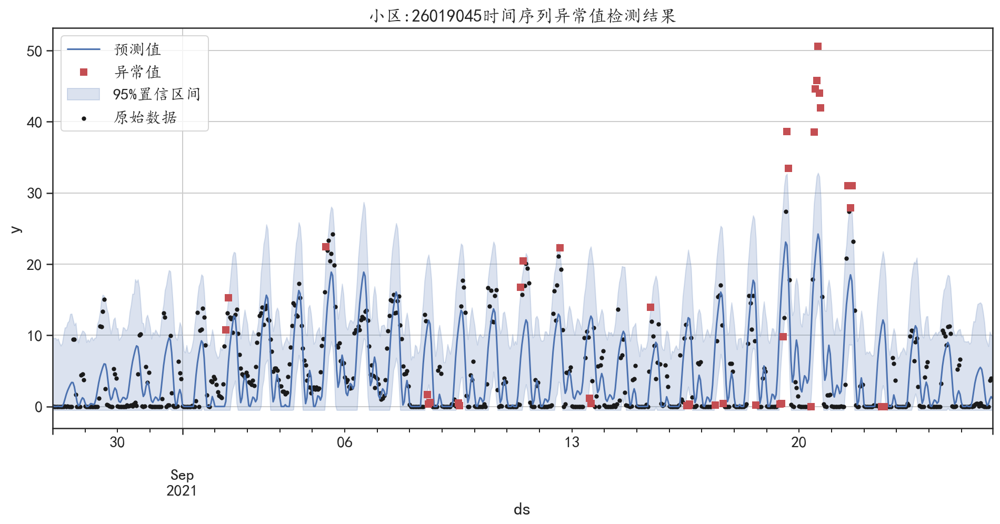

Initial log joint probability = -23.6985
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1200.65     0.0024182       80.8481      0.1816           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154        1203.1   0.000820307       126.754   7.109e-06       0.001      224  LS failed, Hessian reset 
     199       1203.84   2.13793e-05       73.6043           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1203.85   3.83366e-05       65.7378   4.648e-07       0.001      343  LS failed, Hessian reset 
     232       1203.85   4.04013e-06        70.269   5.908e-08       0.001      403  LS failed, Hessian reset 
     259       1203.85   2.07245e-07        67.119   2.953e-09       0.001      479  LS failed, Hessian reset 
     267       1203.85   3.65017e-08       84.7679      0.1737   

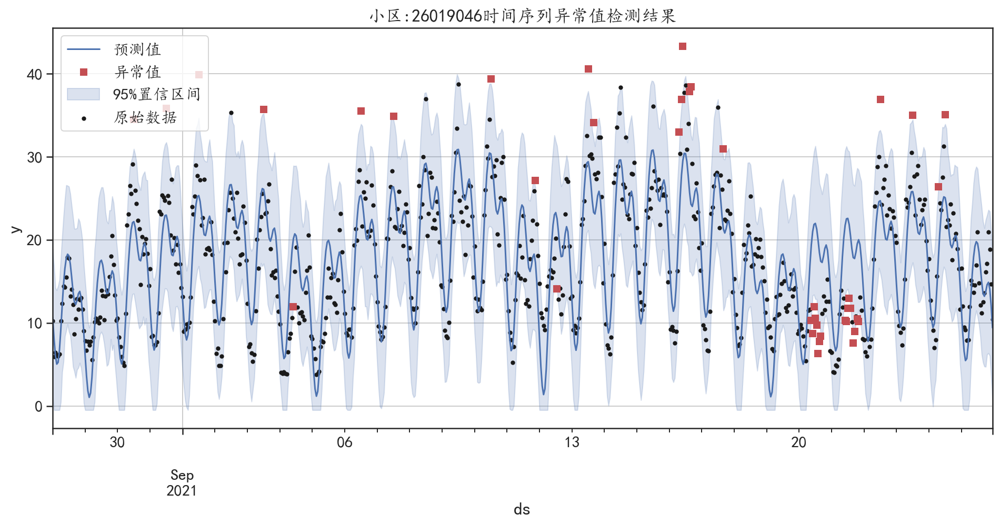

Initial log joint probability = -26.1062
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       1118.88    0.00926724       166.648   8.872e-05       0.001      154  LS failed, Hessian reset 
      99       1119.27    0.00114949       70.1387           1           1      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1119.41   3.63422e-05       73.1403   5.826e-07       0.001      337  LS failed, Hessian reset 
     199       1119.41   5.79351e-06       61.7553       0.606       0.606      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1119.41   1.33368e-05       69.2677   2.378e-07       0.001      449  LS failed, Hessian reset 
     297       1119.41   2.63932e-07       50.5373   4.447e-09       0.001      562  LS failed, Hessian reset 
     299       1119.41    1.4955e-07       48.2925      0.3656   

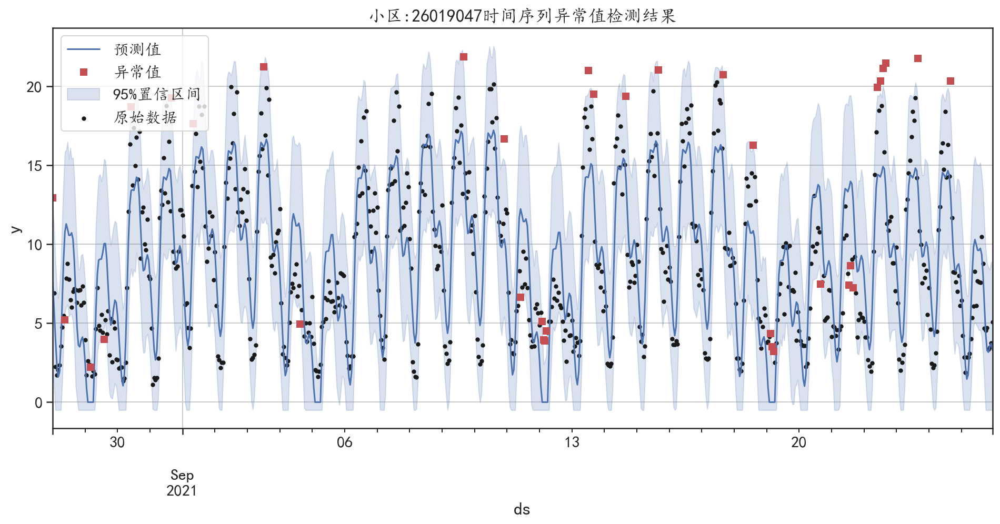

Initial log joint probability = -24.821
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1238.91    0.00991779       134.532      0.3734           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1238.94   0.000428002       78.0263   3.181e-06       0.001      160  LS failed, Hessian reset 
     197       1240.54   0.000273814       72.5365   3.791e-06       0.001      320  LS failed, Hessian reset 
     199       1240.55   0.000182173       70.5669           1           1      322   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1241.31   2.49072e-05       72.0658      0.4482      0.4482      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1241.37   0.000385826       79.5311   4.527e-06       0.001      500  LS failed, Hessian reset

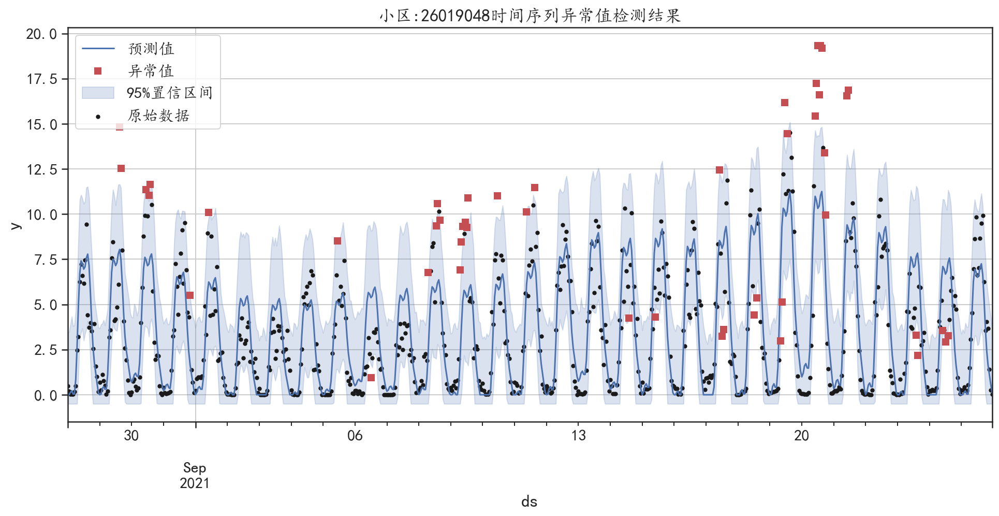

Initial log joint probability = -62.4865
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      61       1180.42   0.000724343       103.143   7.488e-06       0.001      116  LS failed, Hessian reset 
      99       1180.53   2.28164e-05       85.1949      0.9221      0.9221      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       1180.62   0.000150738       79.2751   1.306e-06       0.001      340  LS failed, Hessian reset 
     199       1180.63   6.24007e-05       73.7419           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       1180.65    3.9096e-06       78.9656   4.844e-08       0.001      505  LS failed, Hessian reset 
     299       1180.65   2.75919e-07       63.3497      0.0512      0.8146      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

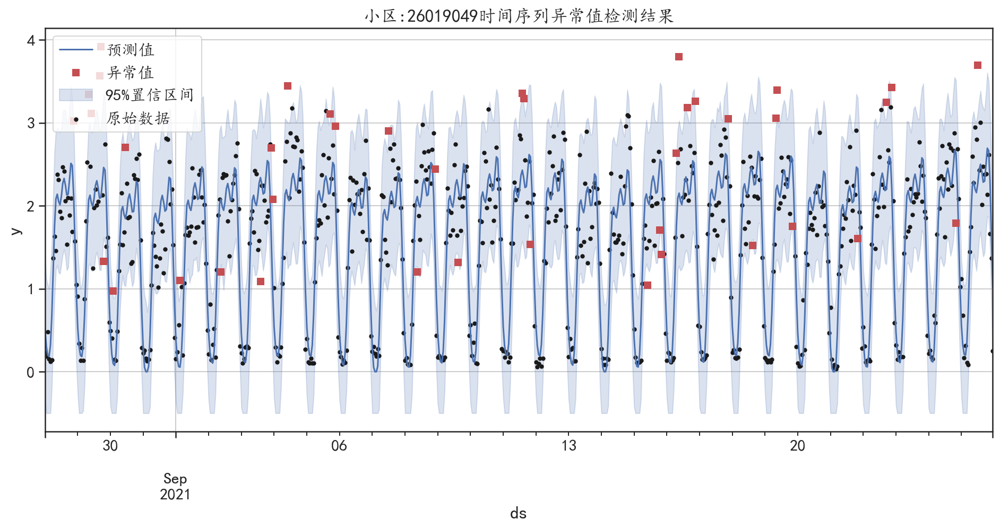

Initial log joint probability = -26.6442
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1145.54     0.0002105       102.184      0.2487           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1145.55   8.48855e-05       82.2791   7.981e-07       0.001      166  LS failed, Hessian reset 
     180       1145.79     0.0017141       95.9003   1.586e-05       0.001      299  LS failed, Hessian reset 
     199       1145.89   4.87585e-05       84.7997      0.5238      0.5238      322   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     260       1146.04    0.00119923       125.047   1.083e-05       0.001      435  LS failed, Hessian reset 
     299       1146.11   8.52377e-07       93.4117      0.2214           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

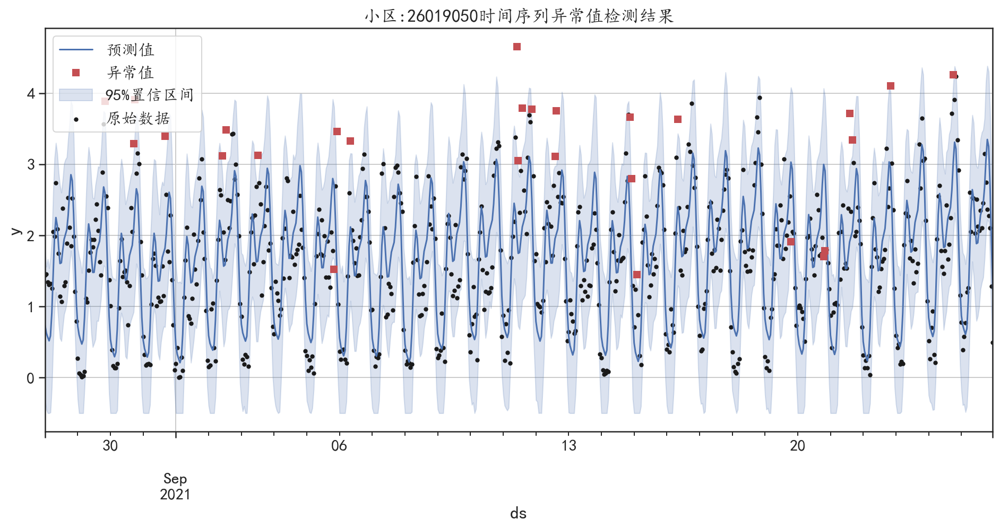

Initial log joint probability = -64.7589
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81       1074.33   0.000410599       61.4192   4.942e-06       0.001      135  LS failed, Hessian reset 
      99       1074.44   0.000161091        76.407           1           1      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1075.03   1.98933e-05       82.6386           1           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       1075.05   9.18414e-05       82.2598   1.101e-06       0.001      365  LS failed, Hessian reset 
     299        1075.1   0.000220709       59.8016           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1076.49   5.71581e-05       69.6327      0.5571      0.5571      560   
    Iter      log pro

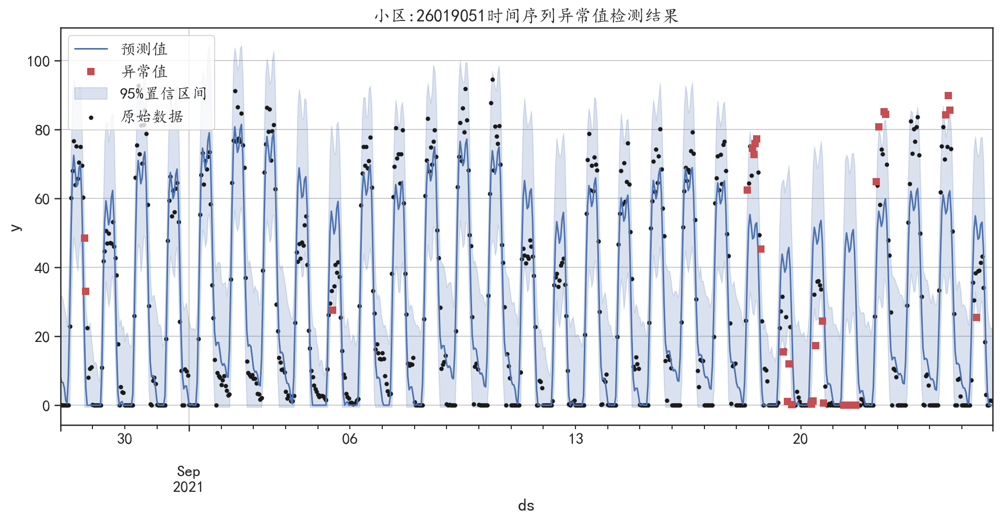

Initial log joint probability = -45.3075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      68       1006.43    0.00197374       152.828   2.425e-05       0.001      129  LS failed, Hessian reset 
      99       1006.62   8.55546e-05       98.3285      0.3728           1      170   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1006.64   7.14969e-05       78.2792   7.182e-07       0.001      239  LS failed, Hessian reset 
     185       1006.65   5.11044e-08       68.7124      0.5903      0.5903      323   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019052   异常值的数量为: 47


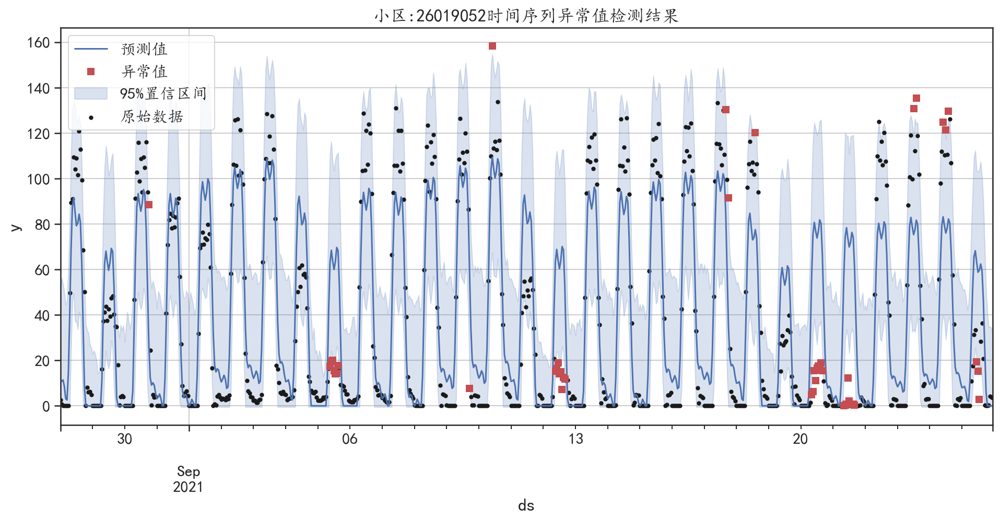

Initial log joint probability = -53.9161
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1036.82   6.02466e-06       85.1861      0.2187      0.2187      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1036.97   4.86076e-06       65.8863           1           1      259   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1036.97   5.65015e-07       61.6783   7.041e-09       0.001      332  LS failed, Hessian reset 
     241       1036.97   5.47863e-08       68.6863      0.4774      0.9973      349   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019053   异常值的数量为: 45


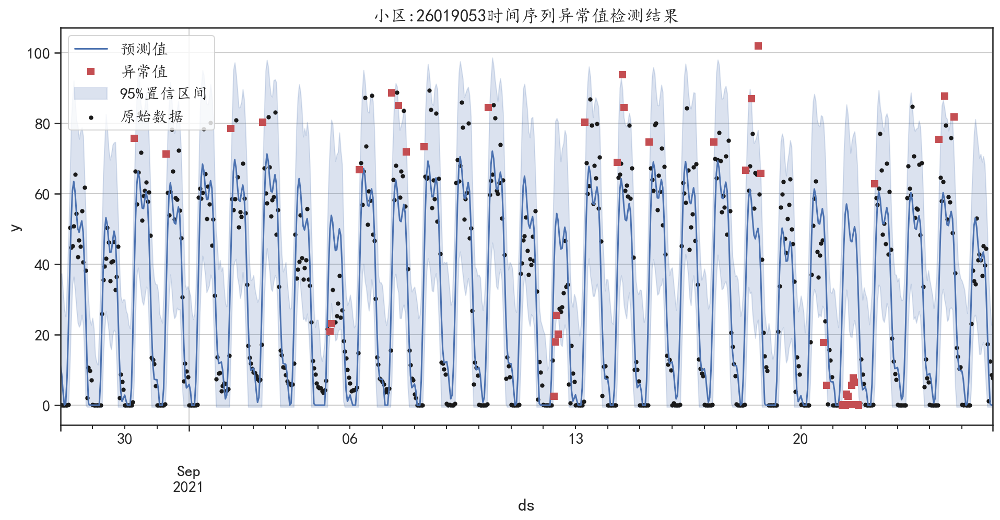

Initial log joint probability = -56.9506
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1050.54   7.33088e-06       93.0715       0.226           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1050.55   9.46177e-05        61.814   9.056e-07       0.001      193  LS failed, Hessian reset 
     163       1050.56   2.29392e-07       78.7468   2.584e-09       0.001      292  LS failed, Hessian reset 
     172       1050.56    3.2964e-08       55.7104      0.3106      0.3106      302   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019054   异常值的数量为: 39


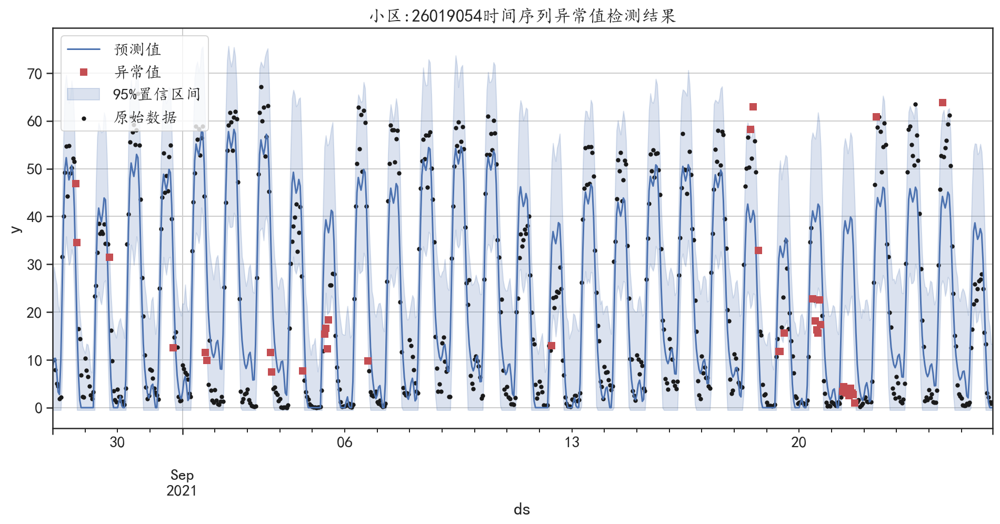

Initial log joint probability = -57.8109
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       949.151   0.000986228       64.7026    1.57e-05       0.001      131  LS failed, Hessian reset 
      99       949.246   1.92617e-05       68.1851           1           1      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       949.254   6.64682e-05       81.4349   9.323e-07       0.001      214  LS failed, Hessian reset 
     147       949.258   3.80141e-06         80.61   5.785e-08       0.001      309  LS failed, Hessian reset 
     158       949.258   2.93177e-08       57.6887      0.2642      0.2642      327   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019055   异常值的数量为: 51


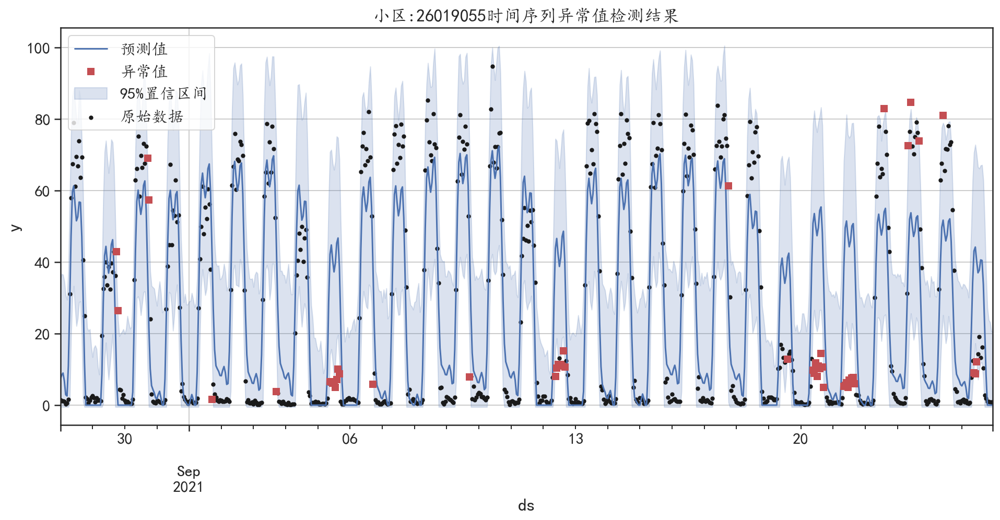

Initial log joint probability = -45.2091
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       1082.55   0.000283639       77.6082   4.399e-06       0.001      144  LS failed, Hessian reset 
      99       1082.57   6.06781e-05       69.2368      0.2603           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1082.63   0.000509922       70.1562      0.4593      0.4593      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1082.66   0.000223325       91.4099    2.72e-06       0.001      386  LS failed, Hessian reset 
     278       1082.71   1.04962e-06       54.0794   1.568e-08       0.001      491  LS failed, Hessian reset 
     299       1082.71   2.63552e-06       81.7714           1           1      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

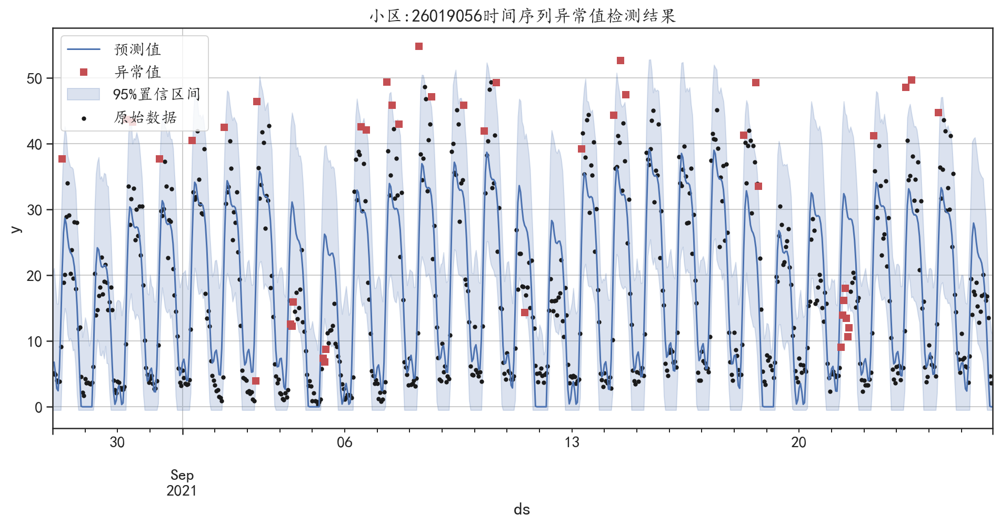

Initial log joint probability = -35.3158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1351.49   0.000155971       61.8748           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1351.51   0.000115312       67.1241   1.275e-06       0.001      172  LS failed, Hessian reset 
     162       1351.52   3.34657e-08       58.3717      0.2159           1      264   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
小区: 26019057   异常值的数量为: 39


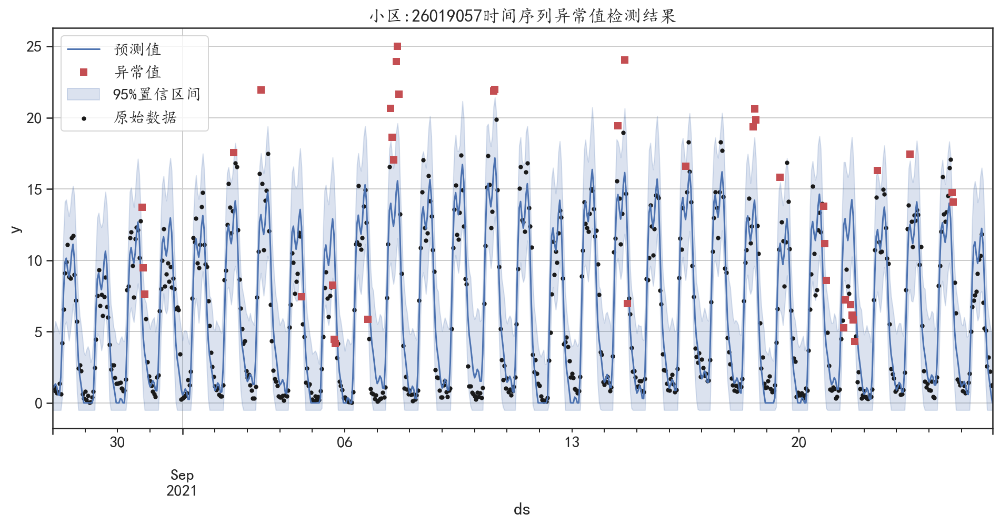

Initial log joint probability = -16.0769
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       984.129   1.37903e-05       76.2524      0.2027      0.2027      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       984.132   4.55987e-09       83.3309     0.07541     0.07541      187   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
小区: 26019058   异常值的数量为: 38


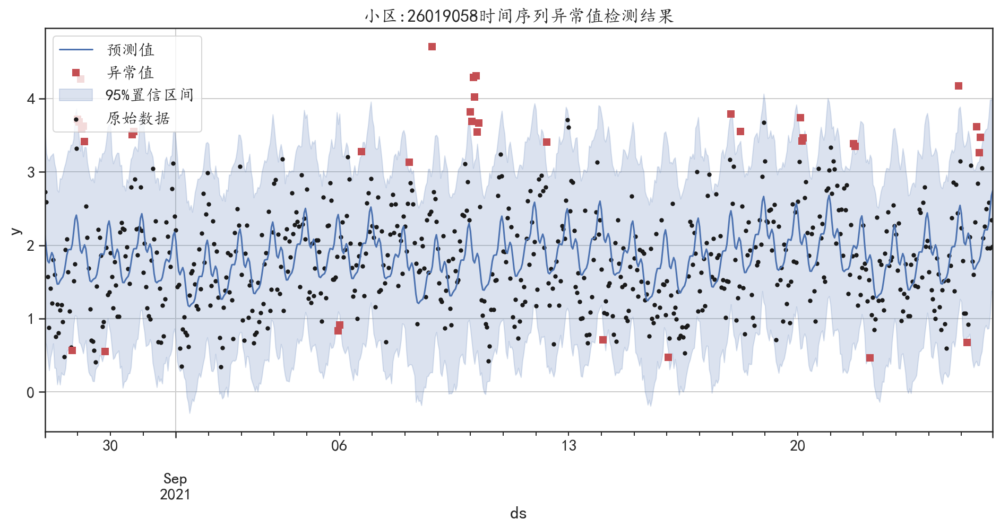

In [6]:
## 检测出的异常值的数量，也会对后面第2个问题的分类模型有影响（或者异常值检测模型）
varname = "number"  ## 需要检测的变量
plotresult = True    ## 是否输出图像

## 获取所有小区的编号
np.random.seed(1234)  ## 设置随机数种子
xiaoqu = np.unique(modeldf["小区编号"])
for ii,xq in enumerate(xiaoqu):
    ## 获取一个小区的数据
    predf = modeldf.loc[modeldf["小区编号"] == xq,["时间",varname]]
    predf.columns = ["ds","y"]
    ## 对一个小区的数据建立一个时间序列模型
    model = Prophet(growth="linear",daily_seasonality = True,
                    weekly_seasonality=True,yearly_seasonality=False,
                    seasonality_mode = 'multiplicative', 
                    interval_width = 0.95,   ## 用于控制异常值的数量（0.95，0.99，0.9等）
                    )
    model = model.fit(predf)     # 使用数据拟合模型
    forecast = model.predict(predf)  # 使用模型对数据进行预测
    forecast["y"] = predf["y"].reset_index(drop = True)
    forecast["yhat"] = np.where(forecast["yhat"]<0,0,forecast["yhat"])  # 有些0数值不能粗暴的认为其就是异常值
    forecast["yhat_lower"] = np.where(forecast["yhat_lower"]<-0.5,-0.5,forecast["yhat_lower"])
    ## 查看异常值预测情况
    outlier_index = outlier_detection(forecast)
    outlier_df = predf[outlier_index]
    print("小区:",xq,"  异常值的数量为:",np.sum(outlier_index))
    ## 获取异常值列表
    outlier_index2 = outlier_detection2(forecast)
    predf["outlier"] = outlier_index2 
    ## 将是否为异常值填写到原始数据中
    modeldf.loc[predf.index,"outlier"] = predf["outlier"]
    ## 可视化预测结果
    if plotresult:
        ## 可视化异常值的结果
        fig, ax = plt.subplots()
        ## 可视化预测值
        forecast.plot(x = "ds",y = "yhat",style = "b-",figsize=(16,7),
                      label = "预测值",ax=ax)
        ## 可视化出置信区间
        ax.fill_between(forecast["ds"].values, forecast["yhat_lower"], 
                        forecast["yhat_upper"],color='b',alpha=.2,
                        label = "95%置信区间")
        forecast.plot(kind = "scatter",x = "ds",y = "y",c = "k",
                      s = 10,label = "原始数据",ax = ax)
        ## 可视化出异常值的点
        outlier_df.plot(x = "ds",y = "y",style = "rs",ax = ax,
                        label = "异常值")
        plt.legend(loc = 2)
        plt.grid()
        plt.title("小区:"+str(xq)+"时间序列异常值检测结果")
        plt.show()


    

In [7]:
## 预测结果的查看
modeldf

,时间,基站编号,小区编号,本地小区标识,number,outlier
0,2021-08-28 00:00:00,1200071,26019014,0,22.6341,False
1,2021-08-28 00:00:00,1200071,26019015,1,19.1064,False
2,2021-08-28 00:00:00,1200071,26019016,2,15.4729,False
3,2021-08-28 00:00:00,1200071,26019023,3,0.0509,False
4,2021-08-28 00:00:00,1200071,26019024,4,0.6355,False
...,...,...,...,...,...,...
40363,2021-09-25 23:00:00,1200075,26019033,7,7.0792,False
40364,2021-09-25 23:00:00,1200075,26019034,8,1.3647,False
40365,2021-09-25 23:00:00,1200075,26019035,9,2.4111,False
40366,2021-09-25 23:00:00,1200075,26019027,10,11.7958,False


<AxesSubplot:xlabel='小区编号'>

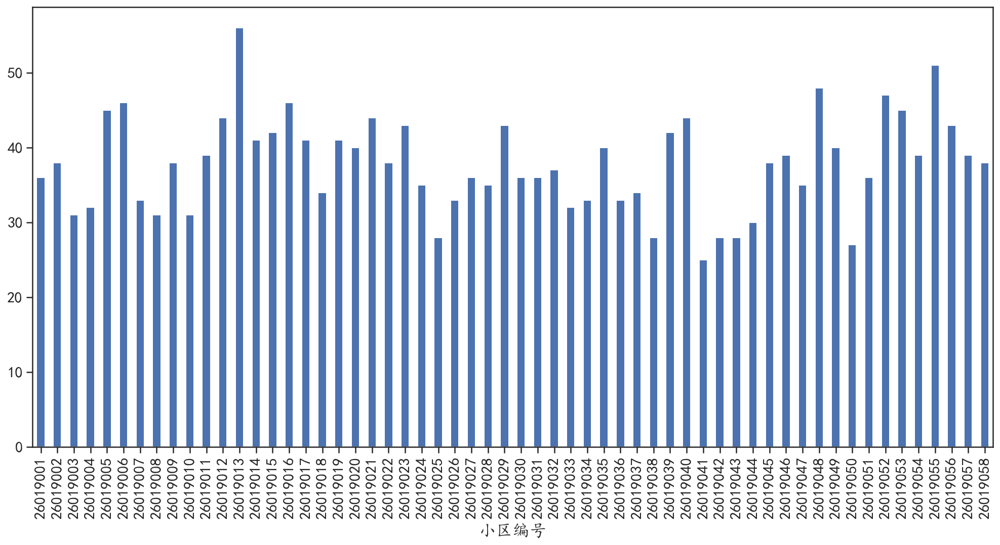

In [8]:
## 计算每个小区的异常值数量
modeldf.groupby("小区编号")["outlier"].sum().plot(kind = "bar",figsize = (17,8))

In [9]:
## 针对是否时异常值区间的数据，根据看是否有几个异常值聚集到一块进行判断即可。其它的变量也可使用同样的方式进行预测与判断是否为异常值


###  利用modeldf的预测结果，建立一个预测未来是否为异常值的模型，二分类模型，由于小区之间的差异性较大，感觉单独为每个小区建立一个模型会更好一些。


In [10]:
## 针对某个小区，只使用时序数据的模型建立
cladf =  modeldf.loc[modeldf["小区编号"] == 26019005,["时间","number","outlier"]]
cladf["outlier"] = np.int32(cladf["outlier"])
cladf

,时间,number,outlier
18,2021-08-28 00:00:00,15.5100,0
76,2021-08-28 01:00:00,13.5003,0
134,2021-08-28 02:00:00,9.3439,0
192,2021-08-28 03:00:00,9.3711,0
250,2021-08-28 04:00:00,8.6753,0
...,...,...,...
40096,2021-09-25 19:00:00,29.3806,0
40154,2021-09-25 20:00:00,21.1153,0
40212,2021-09-25 21:00:00,20.7158,0
40270,2021-09-25 22:00:00,19.1725,0


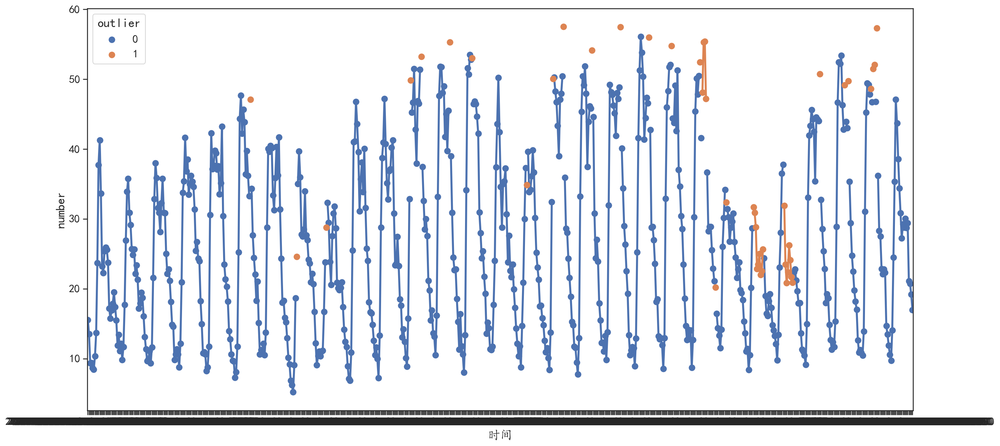

In [11]:
## 可视化时间序列的变化情况
plt.figure(figsize=(20,10))
sns.pointplot(data = cladf,x = "时间",y = "number",hue="outlier")
plt.show()

In [12]:
## 数据准备，使用此否为异常值的前24个样本作为模型的特征(不同的长度会有不同的预测效果)
featurelen = 24
X = []
Y = []
for ii in np.arange(featurelen,len(cladf)):
    X.append(cladf.number.values[(ii-featurelen):ii])
    Y.append(cladf.outlier.values[ii])
X = np.array(X)
Y = np.array(Y)

(672, 2)


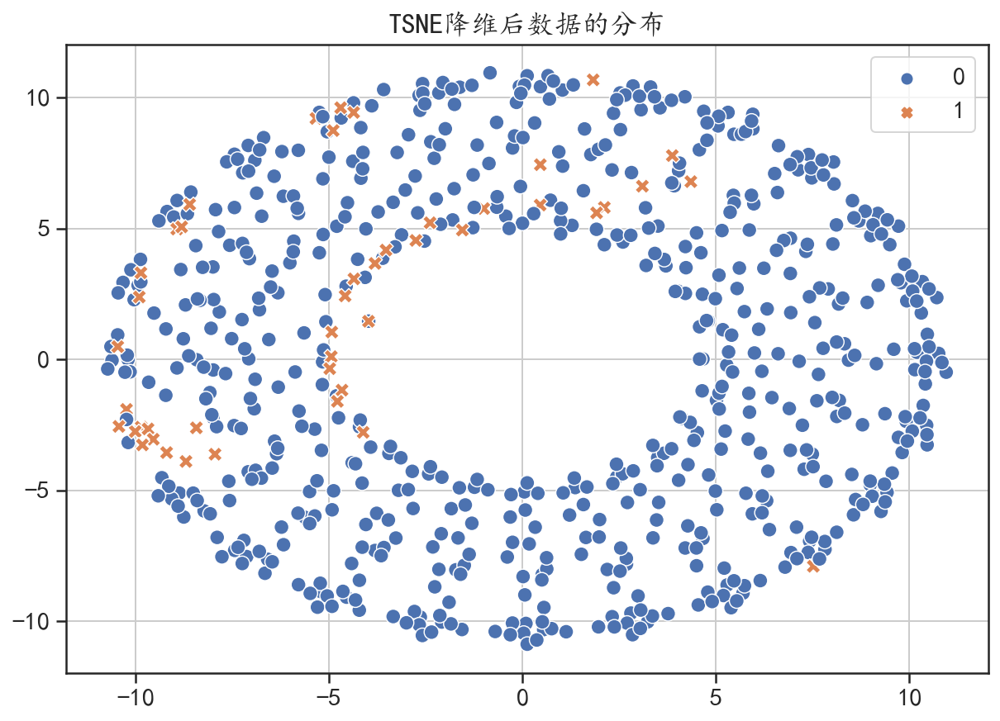

In [13]:
## 数据降维可视化
## TSNE进行数据的降维,降维到2维空间中
tsne = TSNE(n_components = 2,perplexity =100,
            early_exaggeration =5,random_state=123) 

## 获取降维后的数据
tsne_outlier = tsne.fit_transform(X)
print(tsne_outlier.shape)
## 可视化在二维空间中的分布
plt.figure(figsize=(10,7))
sns.scatterplot(x=tsne_outlier[:,0], y=tsne_outlier[:,1],
                style = Y,hue = Y,s = 80)
plt.legend(loc = 1)
plt.grid()
plt.title("TSNE降维后数据的分布")
plt.show()

## 异常值的分布并不那么容易识别

In [14]:
## 针对这样的数据类型，由于异常值的数量很少，所以可以看作是一个二分类问题，也可以看作是一个新的异常值检测问题


## 先使用二分类模型对其进行检测，再介绍一些异常值识别模型的使用

## 数据切分训练集和验证机
X_train, X_test, y_train, y_test = train_test_split(X, Y,test_size=0.25,random_state=2)
print("训练数据:",X_train.shape)
print("训练数据中异常值数量:",np.unique(y_train,return_counts = True))
print("测试数据:",X_test.shape)
print("测试数据中异常值数量:",np.unique(y_test,return_counts = True))

训练数据: (504, 24)
训练数据中异常值数量: (array([0, 1], dtype=int32), array([471,  33]))
测试数据: (168, 24)
测试数据中异常值数量: (array([0, 1], dtype=int32), array([156,  12]))


In [15]:
## 使用基于PCA方法的异常值识别
pcaod = PCA(n_components = "mle",  #自动猜测保留的主成分数量
            n_selected_components = 4, # 计算异常值得分时使用的主成分数量
            contamination = 0.1,    # 异常值所占比例
            random_state = 123)
pcaod.fit(X_train)   ## 对训练数据进行拟合
pcaod_lab = pcaod.labels_
print("在训练集上是否为异常值判断正确的精度为:\n",classification_report(y_train,pcaod_lab))
print("在训练集上是否为异常值判断正确的f1_score为:",f1_score(y_train,pcaod_lab))
## 对测试集进行预测，并计算预测的精度
pcaod_pre = pcaod.predict(X_test)
print("在测试集上是否为异常值判断正确的精度为:\n",classification_report(y_test,pcaod_pre))
print("在测试集上是否为异常值判断正确的f1_score为:",f1_score(y_test,pcaod_pre))

在训练集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       0.93      0.89      0.91       471
           1       0.02      0.03      0.02        33

    accuracy                           0.84       504
   macro avg       0.47      0.46      0.47       504
weighted avg       0.87      0.84      0.85       504

在训练集上是否为异常值判断正确的f1_score为: 0.02380952380952381
在测试集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       0.94      0.85      0.89       156
           1       0.11      0.25      0.15        12

    accuracy                           0.80       168
   macro avg       0.52      0.55      0.52       168
weighted avg       0.88      0.80      0.84       168

在测试集上是否为异常值判断正确的f1_score为: 0.15384615384615383


In [16]:
## SOD是一种子空间异常值检测方法
sod = SOD(n_neighbors = 20,  ## 使用K近邻查询是的近邻数量
          ref_set = 10, ## 创建参考集的共享最近邻居的数量
          alpha = 0.85, ## 选择指定子空间的下限
          contamination  = 0.1)
sod.fit(X_train)
sod_lab = sod.labels_
print("在训练集上是否为异常值判断正确的精度为:\n",classification_report(y_train,sod_lab))
print("在训练集上是否为异常值判断正确的f1_score为:",f1_score(y_train,sod_lab))
## 对测试集进行预测,并计算预测精度
sod_pre = sod.predict(X_test)
print("在测试集上是否为异常值判断正确的精度为:\n",classification_report(y_test,sod_pre))
print("在测试集上是否为异常值判断正确的f1_score为:",f1_score(y_test,sod_pre))

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


在训练集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       0.93      0.90      0.91       471
           1       0.04      0.06      0.05        33

    accuracy                           0.84       504
   macro avg       0.49      0.48      0.48       504
weighted avg       0.87      0.84      0.86       504

在训练集上是否为异常值判断正确的f1_score为: 0.04761904761904762
在测试集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       0.94      0.71      0.81       156
           1       0.10      0.42      0.16        12

    accuracy                           0.69       168
   macro avg       0.52      0.56      0.49       168
weighted avg       0.88      0.69      0.76       168

在测试集上是否为异常值判断正确的f1_score为: 0.16129032258064516


In [17]:
xgod = XGBOD(n_estimators =100, ## 树的数量
             max_depth = 10,    # 最大深度
             learning_rate = 0.1, # 学习率 
             reg_alpha = 0.01, # L1范数约束的权重
             random_state = 12)
## 注意在拟合该模型时，使用了是否为异常值的标签进了监督
xgod.fit(X_train,y_train)  
xgod_lab = xgod.labels_
print("在训练集上是否为异常值判断正确的精度为:\n",classification_report(y_train,xgod_lab))
print("在训练集上是否为异常值判断正确的f1_score为:",f1_score(y_train,xgod_lab))
## 对测试集进行预测,并计算预测精度
xgod_pre = xgod.predict(X_test)
print("在测试集上是否为异常值判断正确的精度为:\n",classification_report(y_test,xgod_pre))
print("在测试集上是否为异常值判断正确的f1_score为:",f1_score(y_test,xgod_pre))

/Users/daitu/opt/anaconda3/envs/DataVis/lib/python3.8/site-packages/pyod/models/base.py:415: UserWarning: y should not be presented in unsupervised learning.
  warnings.warn(
/Users/daitu/opt/anaconda3/envs/DataVis/lib/python3.8/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[15:42:04] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:576: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[15:42:04] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
在训练集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       471
           1       1.00      1.00      1.00        33

    accuracy                           1.00       504
   macro avg       1.00      1.00      1.00       504
weighted avg       1.00      1.00    

### XGBOD 效果较好，因为它使用了类别标签

In [18]:
## 介绍使用SVM分类器建立分类模型（这里只介绍这一种方法，其它的就不再介绍了）
## 建立非线性SVM模型，使用rbf核
rbfsvm = SVC(kernel  = "rbf",gamma=0.0001, ## RBF核和对应的参数
             random_state= 1,C=1000)
## 训练模型
rbfsvm.fit(X_train,y_train)
## 计算在训练集和测试集上的预测精度
rbfsvm_lab = rbfsvm.predict(X_train)
rbfsvm_pre = rbfsvm.predict(X_test)
print("训练集预测精度:",accuracy_score(y_train,rbfsvm_lab))
print("测试集预测精度:",accuracy_score(y_test,rbfsvm_pre))
print("训练集预测精度:",f1_score(y_train,rbfsvm_lab))
print("测试集预测精度:",f1_score(y_test,rbfsvm_pre))
print("在训练集上是否为异常值判断正确的精度为:\n",classification_report(y_train,rbfsvm_lab))
print("在测试集上是否为异常值判断正确的精度为:\n",classification_report(y_test,rbfsvm_pre))

训练集预测精度: 1.0
测试集预测精度: 0.9285714285714286
训练集预测精度: 1.0
测试集预测精度: 0.5
在训练集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       471
           1       1.00      1.00      1.00        33

    accuracy                           1.00       504
   macro avg       1.00      1.00      1.00       504
weighted avg       1.00      1.00      1.00       504

在测试集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       0.96      0.96      0.96       156
           1       0.50      0.50      0.50        12

    accuracy                           0.93       168
   macro avg       0.73      0.73      0.73       168
weighted avg       0.93      0.93      0.93       168



### 二分类算法的效果会更好（针对类别不平衡的数据，还可以考虑使用一些数据平衡的方法）

### 针对某小区使用更多的特征

In [19]:
usedatadf.columns

## 这里我们添加几个作为示例，还可使用更多的其它特征
myaddusefeature = ['上行可用的PRB个数', '下行可用的PRB个数',
       '上行PhysicalResourceBlock被使用的平均个数', '下行PhysicalResourceBlock被使用的平均个数',
       '上行PUSCH的PhysicalResourceBlock被使用的平均个数','ERAB建立成功总次数', 'ERAB建立尝试总次数',
       'ERAB异常释放总次数', 'ERAB正常释放总次数', '系统间切换出ERAB正常释放总次数', 'eNodeB内同频切换出成功次数',
       'eNodeB间同频切换出成功次数', 'eNodeB内同频切换出执行次数', 'eNodeB间同频切换出执行次数',
       'eNodeB内异频切换出成功次数', 'eNodeB间异频切换出成功次数']

In [20]:
## 针对某个小区，只使用时序数据的模型建立
cladf2 =  usedatadf.loc[usedatadf["小区编号"] == 26019005,myaddusefeature]
cladf2

,上行可用的PRB个数,下行可用的PRB个数,上行PhysicalResourceBlock被使用的平均个数,下行PhysicalResourceBlock被使用的平均个数,上行PUSCH的PhysicalResourceBlock被使用的平均个数,ERAB建立成功总次数,ERAB建立尝试总次数,ERAB异常释放总次数,ERAB正常释放总次数,系统间切换出ERAB正常释放总次数,eNodeB内同频切换出成功次数,eNodeB间同频切换出成功次数,eNodeB内同频切换出执行次数,eNodeB间同频切换出执行次数,eNodeB内异频切换出成功次数,eNodeB间异频切换出成功次数
18,100,100,8.6102,21.4134,4.5893,3961,3961,0,4008,0,119,321,119,322,4,7
76,100,100,7.3371,17.7044,3.3577,4345,4345,0,4362,0,95,133,95,133,0,3
134,100,100,6.4366,7.5928,2.4736,3508,3508,0,3541,0,104,99,104,99,0,2
192,100,100,6.1496,7.7304,2.1808,3714,3716,0,3723,0,49,84,49,84,0,3
250,100,100,5.3418,5.1037,1.4129,3754,3754,0,3751,0,43,64,43,65,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40096,100,100,16.6807,34.8728,12.2390,4821,4823,2,4582,0,868,1432,868,1433,1,71
40154,100,100,16.9814,25.6097,12.6263,3158,3161,0,3034,0,664,1396,667,1396,2,68
40212,100,100,13.6847,35.7595,9.5000,3082,3082,0,2992,0,561,915,561,915,0,45
40270,100,100,16.0122,37.4606,11.9351,2601,2603,0,2576,0,474,774,474,774,0,29


In [21]:
cladf2[(25-featurelen):25].apply(func = np.mean,axis= 0)

上行可用的PRB个数                                100.000000
下行可用的PRB个数                                100.000000
上行PhysicalResourceBlock被使用的平均个数            10.882679
下行PhysicalResourceBlock被使用的平均个数            26.663988
上行PUSCH的PhysicalResourceBlock被使用的平均个数       6.953225
ERAB建立成功总次数                              6219.958333
ERAB建立尝试总次数                              6223.375000
ERAB异常释放总次数                                 0.458333
ERAB正常释放总次数                              6287.125000
系统间切换出ERAB正常释放总次数                           0.000000
eNodeB内同频切换出成功次数                          376.875000
eNodeB间同频切换出成功次数                          844.708333
eNodeB内同频切换出执行次数                          377.000000
eNodeB间同频切换出执行次数                          845.458333
eNodeB内异频切换出成功次数                            0.208333
eNodeB间异频切换出成功次数                           49.375000
dtype: float64

In [22]:
## 数据准备，使用此否为异常值的前24个样本作为模型的特征(不同的长度会有不同的预测效果)
featurelen = 24
X2 = []
for ii in np.arange(featurelen,len(cladf2)):
    X2.append(cladf2[(25-featurelen):25].apply(func = np.mean,axis= 0).values)
X2 = np.array(X2)
print(X2.shape)

(672, 16)


In [23]:
## 将X2和前面的X拼接，获得新的X
X = np.hstack((X,X2))
print(X.shape)

(672, 40)


In [24]:
Y.shape

(672,)

In [25]:
## 对拼接后的X进行标准化处理
Xs = StandardScaler().fit_transform(X)
## 数据切分训练集和验证机
X_train, X_test, y_train, y_test = train_test_split(Xs, Y,test_size=0.25,random_state=2)
print("训练数据:",X_train.shape)
print("训练数据中异常值数量:",np.unique(y_train,return_counts = True))
print("测试数据:",X_test.shape)
print("测试数据中异常值数量:",np.unique(y_test,return_counts = True))

训练数据: (504, 40)
训练数据中异常值数量: (array([0, 1], dtype=int32), array([471,  33]))
测试数据: (168, 40)
测试数据中异常值数量: (array([0, 1], dtype=int32), array([156,  12]))


### 新的数据准备好后，可以采用与上面相同的方式，建立分类模型

(672, 2)


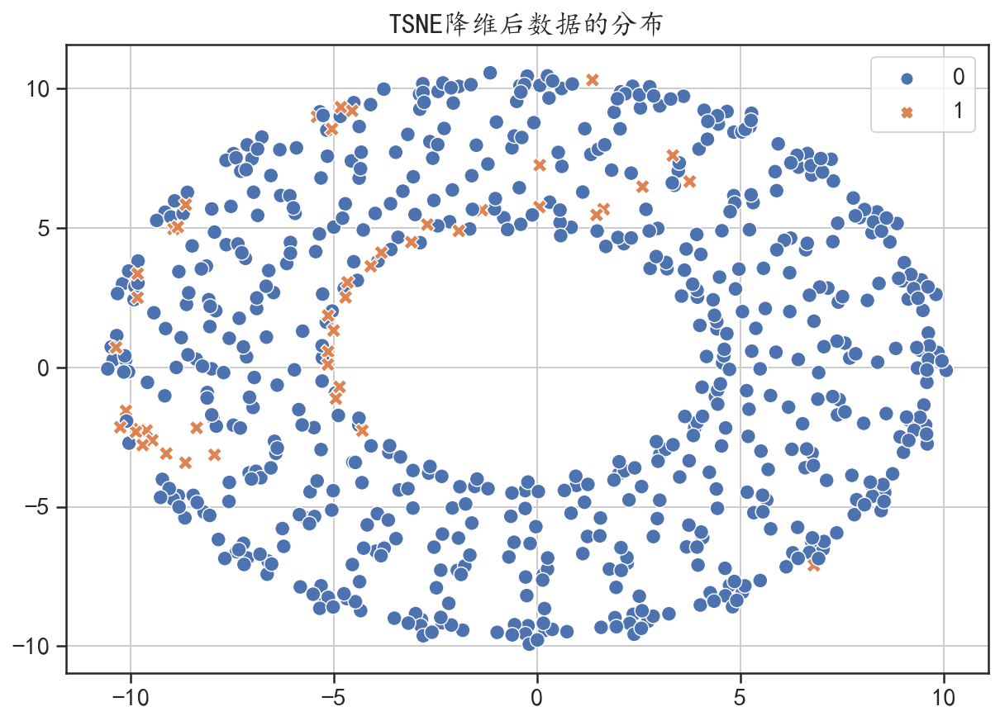

In [26]:

## TSNE进行数据的降维,降维到2维空间中
tsne = TSNE(n_components = 2,perplexity =100,
            early_exaggeration =5,random_state=123) 

## 获取降维后的数据
tsne_outlier = tsne.fit_transform(Xs)
print(tsne_outlier.shape)
## 可视化在二维空间中的分布
plt.figure(figsize=(10,7))
sns.scatterplot(x=tsne_outlier[:,0], y=tsne_outlier[:,1],
                style = Y,hue = Y,s = 80)
plt.legend(loc = 1)
plt.grid()
plt.title("TSNE降维后数据的分布")
plt.show()

In [27]:
## 介绍使用SVM分类器建立分类模型（这里只介绍这一种方法，其它的就不再介绍了）
## 建立非线性SVM模型，使用rbf核
rbfsvm = SVC(kernel  = "rbf",gamma=0.1, ## RBF核和对应的参数
             random_state= 1,C=10)
## 训练模型
rbfsvm.fit(X_train,y_train)
## 计算在训练集和测试集上的预测精度
rbfsvm_lab = rbfsvm.predict(X_train)
rbfsvm_pre = rbfsvm.predict(X_test)
print("训练集预测精度:",accuracy_score(y_train,rbfsvm_lab))
print("测试集预测精度:",accuracy_score(y_test,rbfsvm_pre))
print("训练集预测精度f1_score:",f1_score(y_train,rbfsvm_lab))
print("测试集预测精度f1_score:",f1_score(y_test,rbfsvm_pre))
print("在训练集上是否为异常值判断正确的精度为:\n",classification_report(y_train,rbfsvm_lab))
print("在测试集上是否为异常值判断正确的精度为:\n",classification_report(y_test,rbfsvm_pre))

## 通过参数调整，可能也可以获得较好的预测效果（也可能不会）

训练集预测精度: 0.996031746031746
测试集预测精度: 0.9285714285714286
训练集预测精度f1_score: 0.9696969696969697
测试集预测精度f1_score: 0.45454545454545453
在训练集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       471
           1       0.97      0.97      0.97        33

    accuracy                           1.00       504
   macro avg       0.98      0.98      0.98       504
weighted avg       1.00      1.00      1.00       504

在测试集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       0.96      0.97      0.96       156
           1       0.50      0.42      0.45        12

    accuracy                           0.93       168
   macro avg       0.73      0.69      0.71       168
weighted avg       0.92      0.93      0.93       168



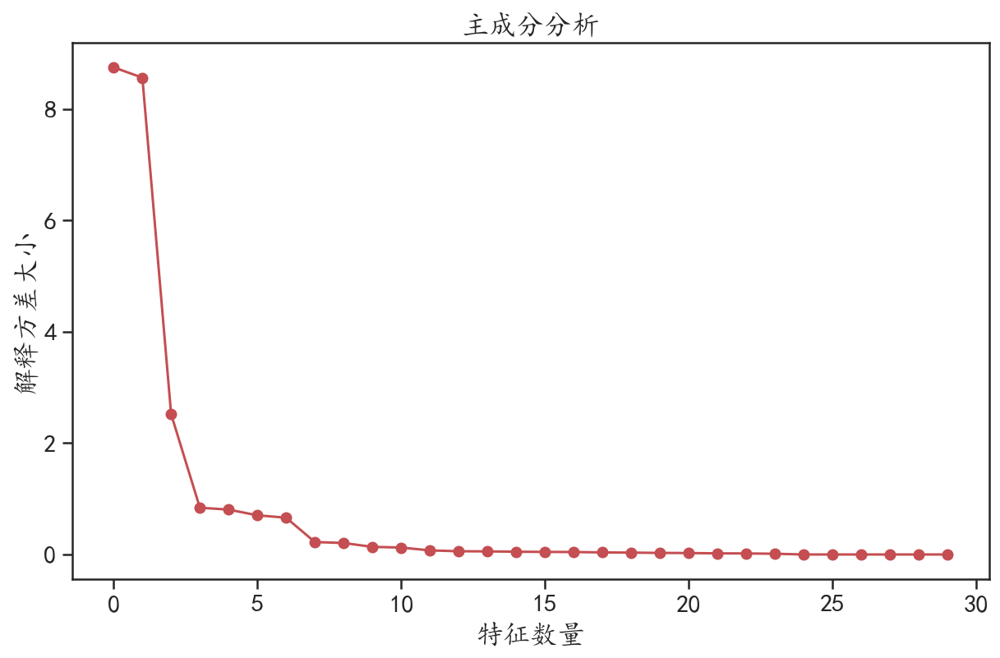

In [28]:
## 对数据特征进行一次降维式的特征提取，看能否获得较好的结果。以PCA为例
from sklearn.decomposition import PCA

## 使用主成分分析对酒数据集进行降维
pca = PCA(n_components = 30,random_state = 123)
pca.fit(Xs)
## 可视化主成分分析的解释方差得分
exvar = pca.explained_variance_
plt.figure(figsize=(10,6))
plt.plot(exvar,"r-o")
plt.xlabel("特征数量")
plt.ylabel("解释方差大小")
plt.title("主成分分析")
plt.show()

## 先使用前10个主成分

In [29]:
pca_Xs = pca.transform(Xs)[:,0:10]
print(pca_Xs.shape)

## 数据切分训练集和验证机
X_train, X_test, y_train, y_test = train_test_split(pca_Xs, Y,test_size=0.25,random_state=2)
print("训练数据:",X_train.shape)
print("训练数据中异常值数量:",np.unique(y_train,return_counts = True))
print("测试数据:",X_test.shape)
print("测试数据中异常值数量:",np.unique(y_test,return_counts = True))

(672, 10)
训练数据: (504, 10)
训练数据中异常值数量: (array([0, 1], dtype=int32), array([471,  33]))
测试数据: (168, 10)
测试数据中异常值数量: (array([0, 1], dtype=int32), array([156,  12]))


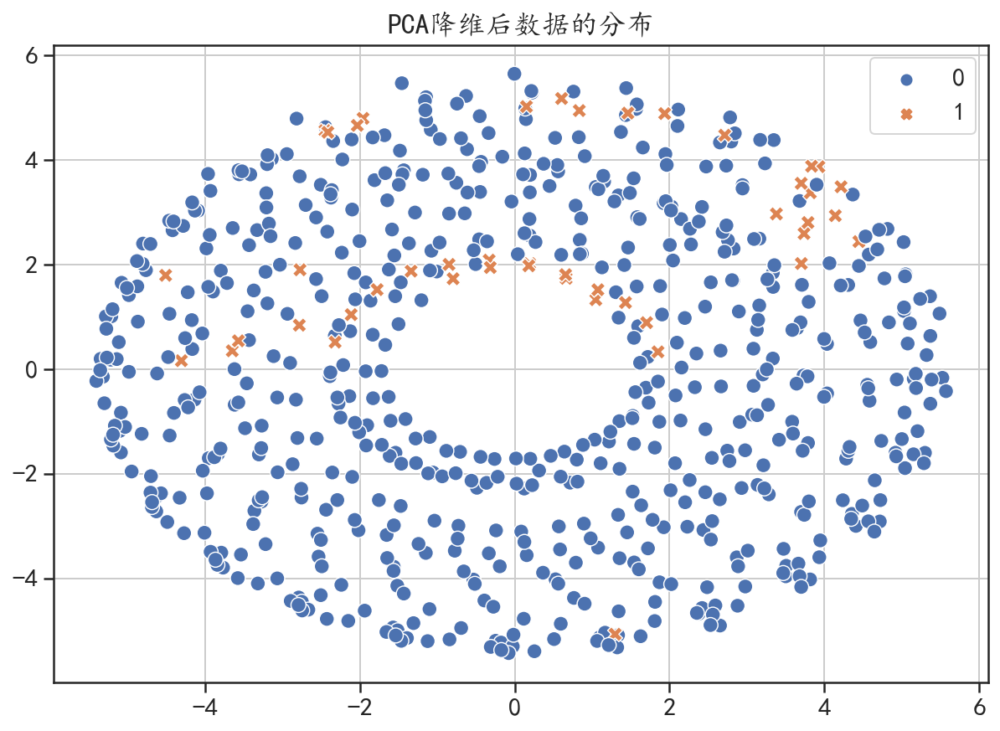

In [30]:
## 获取降维后的数据可视化
## 可视化在二维空间中的分布
plt.figure(figsize=(10,7))
sns.scatterplot(x=pca_Xs[:,0], y=pca_Xs[:,1],
                style = Y,hue = Y,s = 80)
plt.legend(loc = 1)
plt.grid()
plt.title("PCA降维后数据的分布")
plt.show()

In [31]:
# 建立非线性SVM模型，使用rbf核
rbfsvm = SVC(kernel  = "rbf",gamma=0.1, ## RBF核和对应的参数
             random_state= 1,C=100)
## 训练模型
rbfsvm.fit(X_train,y_train)
## 计算在训练集和测试集上的预测精度
rbfsvm_lab = rbfsvm.predict(X_train)
rbfsvm_pre = rbfsvm.predict(X_test)
print("训练集预测精度:",accuracy_score(y_train,rbfsvm_lab))
print("测试集预测精度:",accuracy_score(y_test,rbfsvm_pre))
print("训练集预测精度f1_score:",f1_score(y_train,rbfsvm_lab))
print("测试集预测精度f1_score:",f1_score(y_test,rbfsvm_pre))
print("在训练集上是否为异常值判断正确的精度为:\n",classification_report(y_train,rbfsvm_lab))
print("在测试集上是否为异常值判断正确的精度为:\n",classification_report(y_test,rbfsvm_pre))

## 通过参数调整，可能也可以获得较好的预测效果（也可能不会）(利用主成分特征，效果有所增加)

训练集预测精度: 1.0
测试集预测精度: 0.9523809523809523
训练集预测精度f1_score: 1.0
测试集预测精度f1_score: 0.6666666666666666
在训练集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       471
           1       1.00      1.00      1.00        33

    accuracy                           1.00       504
   macro avg       1.00      1.00      1.00       504
weighted avg       1.00      1.00      1.00       504

在测试集上是否为异常值判断正确的精度为:
               precision    recall  f1-score   support

           0       0.97      0.97      0.97       156
           1       0.67      0.67      0.67        12

    accuracy                           0.95       168
   macro avg       0.82      0.82      0.82       168
weighted avg       0.95      0.95      0.95       168



### 注意：因为我们的小区较多，所以不可能手动的进行对每个小区，调出一组合适的建模参数，因此可以采用参数搜索的方式，自动的为每个小区建模获得较优的一组参数和模型

In [34]:
## 使用参数搜索的基本模式
## 定义模型
svc = SVC(kernel  = "rbf")

## 定义网格搜索的参数
gammas=[0.001,0.001,0.1,10]
Cs = [0.5,5,50,100,1000]
para_grid = {"gamma": gammas,"C":Cs}

## 使用5折交叉验证进行搜索,使用均方根误差的负数作为得分
gs_svr = GridSearchCV(svc,para_grid,cv = 4,n_jobs=4,
                      scoring = "f1")
gs_svr.fit(X_train,y_train)

GridSearchCV(cv=4, estimator=SVC(), n_jobs=4,
             param_grid={'C': [0.5, 5, 50, 100, 1000],
                         'gamma': [0.001, 0.001, 0.1, 10]},
             scoring='f1')

In [35]:
print("最好模型使用的参数为:\n",gs_svr.best_params_)
rbfsvr_lab = gs_svr.best_estimator_.predict(X_train)
rbfsvr_pre = gs_svr.best_estimator_.predict(X_test)
print("训练数据集上的均方根误差:",f1_score(y_train,rbfsvr_lab))
print("测试数据集上的均方根误差:",f1_score(y_test,rbfsvr_pre))

## 可以发现在测试集上的预测精度更高了

最好模型使用的参数为:
 {'C': 5, 'gamma': 0.1}
训练数据集上的均方根误差: 0.7272727272727273
测试数据集上的均方根误差: 0.47058823529411764


In [36]:
## 将上面的程序进行相应的修改、组合、拼接，可以同时兼顾问题2中需要考虑的两点。